In [1]:
from src.dataloader import ImageDataset
from src.model import Classifier,Config,CNNFeatureExtractor,ClassicalFeatureExtractor,load
from src.trainer import ModelTrainer
from torch.utils.data import random_split,Subset
import torch
import os
import time
import numpy as np
import cv2
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split

In [ ]:
config = Config()
BATCH_SIZE = 32
ROOT_DATA_PATH = './dataset/RealWaste'
SEED = 64
EPOCHS = 40
VIS_EVERY=5

In [3]:
config.conv_hidden_dim=3
config.fc_num_layers=2
config.img_size=(128,128)

In [4]:
dataset = ImageDataset(ROOT_DATA_PATH,config.img_size)

In [5]:
labels = [item['id'] for item in dataset.data]

In [6]:
# Stratified Sampling for train and val
train_idx, validation_idx = train_test_split(np.arange(len(dataset)),
                                             test_size=0.2,
                                             random_state=SEED,
                                             shuffle=True,
                                             stratify=labels)

# Subset dataset for train and val
train_dataset = Subset(dataset, train_idx)
val_dataset = Subset(dataset, validation_idx)

In [7]:
print(train_dataset.dataset.classes)
print(val_dataset.dataset.classes)

['Cardboard', 'Food Organics', 'Glass', 'Metal', 'Miscellaneous Trash', 'Paper', 'Plastic', 'Textile Trash', 'Vegetation']
['Cardboard', 'Food Organics', 'Glass', 'Metal', 'Miscellaneous Trash', 'Paper', 'Plastic', 'Textile Trash', 'Vegetation']


In [8]:
sample = val_dataset.dataset.data[0]
img = cv2.imread(sample['image_path'])
img = cv2.resize(img,(config.img_size))
img = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
img = img.astype(np.float32) / 255.0

In [9]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [10]:
backbone = CNNFeatureExtractor(config).to(device)
cnnmodel = Classifier(backbone,train_dataset.dataset.classes,config).to(device)

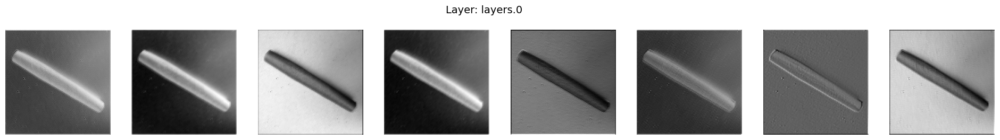

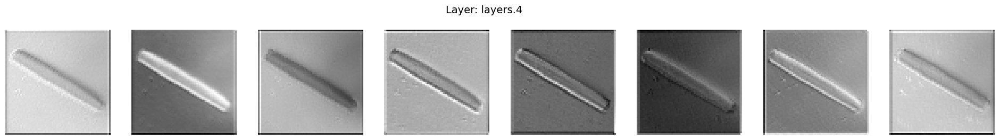

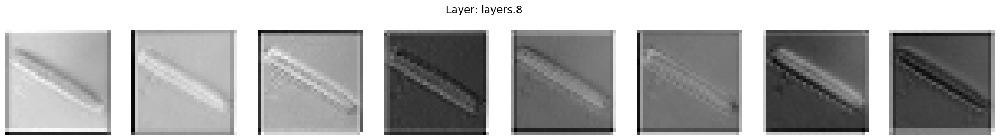

In [11]:
_ = cnnmodel.backbone.visualize(img)

In [12]:
trainer = ModelTrainer(cnnmodel,train_dataset,val_dataset,batch_size=BATCH_SIZE,lr=1e-3,device=device,seed=SEED)

In [13]:
start_time = time.time()

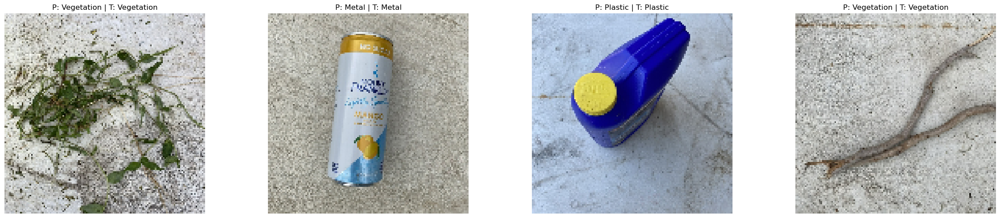

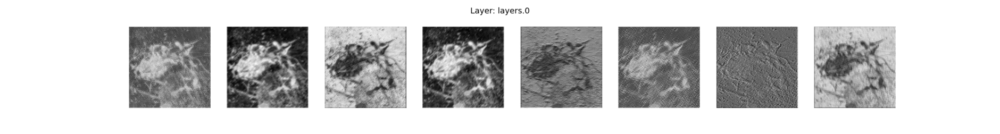

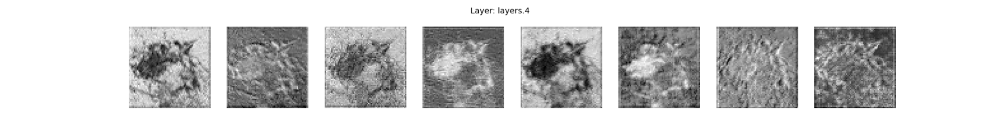

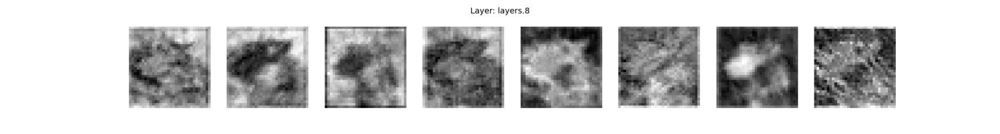

Epoch 1 Train Loss: 1.3690 | Train Acc : 0.5304 | Val Loss : 1.0755 | Val Acc : 0.6162


Epoch 2 Train Loss: 1.0121 | Train Acc : 0.6469 | Val Loss : 1.1077 | Val Acc : 0.5962


Epoch 3 Train Loss: 0.8621 | Train Acc : 0.6938 | Val Loss : 1.2514 | Val Acc : 0.5846


Epoch 4 Train Loss: 0.7160 | Train Acc : 0.7477 | Val Loss : 0.9454 | Val Acc : 0.6519


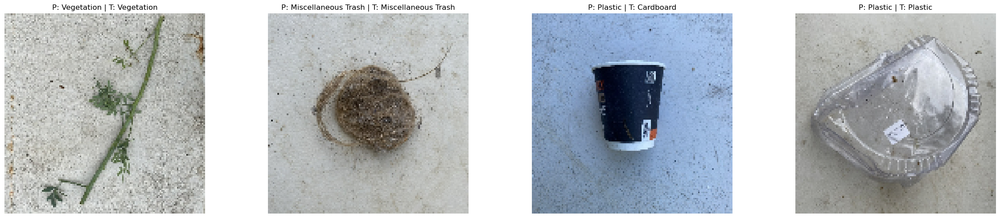

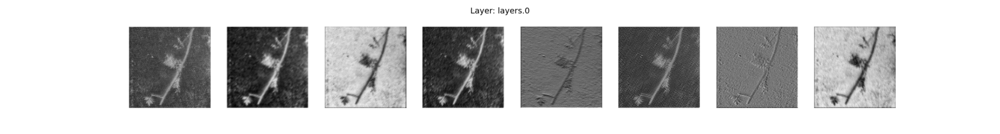

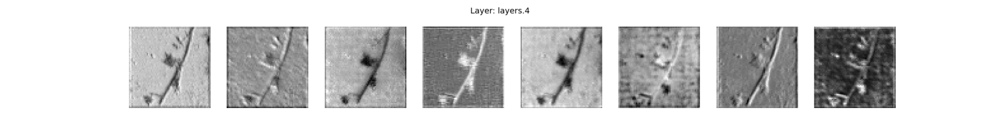

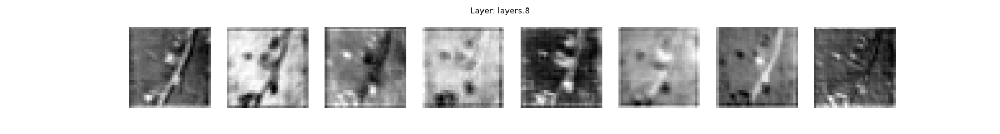

Epoch 5 Train Loss: 0.5805 | Train Acc : 0.7993 | Val Loss : 1.1414 | Val Acc : 0.6099


Epoch 6 Train Loss: 0.4833 | Train Acc : 0.8332 | Val Loss : 2.0252 | Val Acc : 0.4301


Epoch 7 Train Loss: 0.3859 | Train Acc : 0.8658 | Val Loss : 1.1595 | Val Acc : 0.6278


Epoch 8 Train Loss: 0.3020 | Train Acc : 0.9000 | Val Loss : 1.3554 | Val Acc : 0.5752


Epoch 9 Train Loss: 0.2542 | Train Acc : 0.9169 | Val Loss : 0.8719 | Val Acc : 0.7171


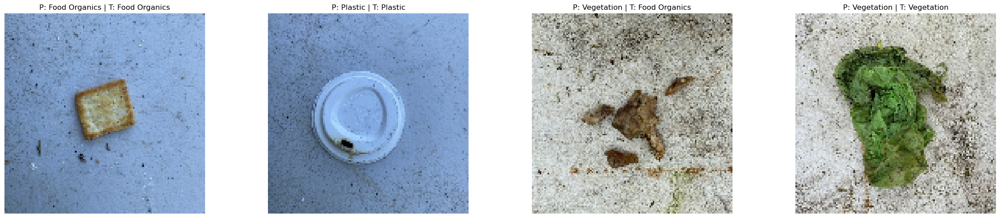

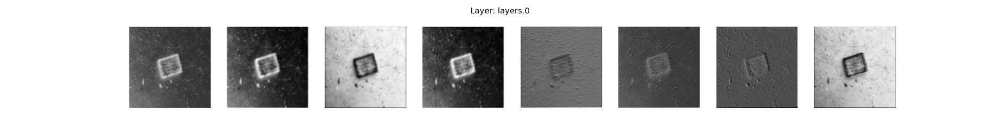

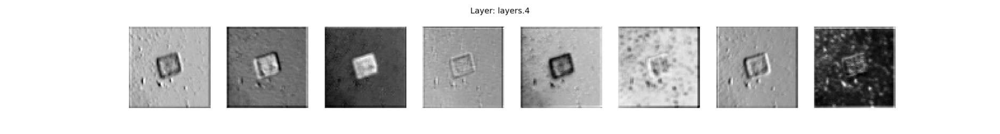

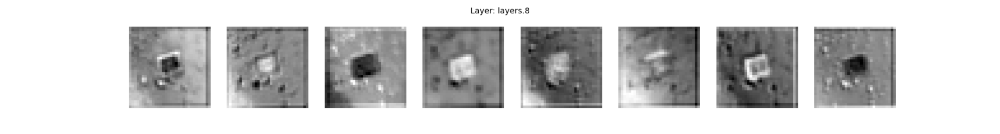

Epoch 10 Train Loss: 0.1921 | Train Acc : 0.9392 | Val Loss : 1.0293 | Val Acc : 0.6667


Epoch 11 Train Loss: 0.1728 | Train Acc : 0.9448 | Val Loss : 0.8613 | Val Acc : 0.7161


Epoch 12 Train Loss: 0.1492 | Train Acc : 0.9519 | Val Loss : 1.0849 | Val Acc : 0.6814


Epoch 13 Train Loss: 0.1438 | Train Acc : 0.9503 | Val Loss : 1.0035 | Val Acc : 0.7024


Epoch 14 Train Loss: 0.1380 | Train Acc : 0.9521 | Val Loss : 0.9754 | Val Acc : 0.7003


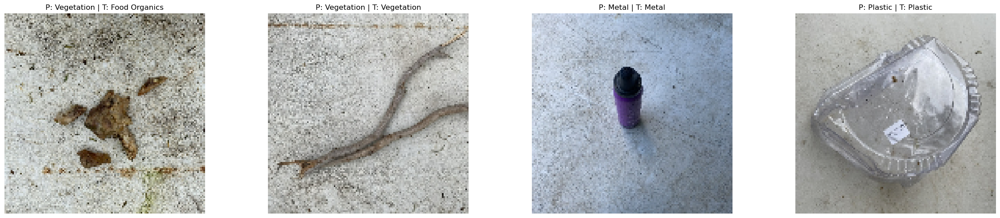

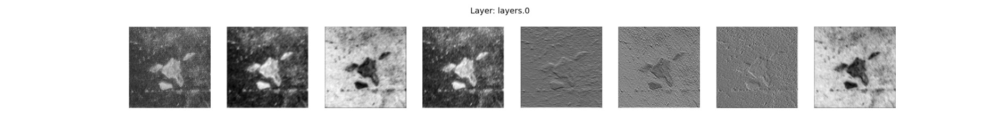

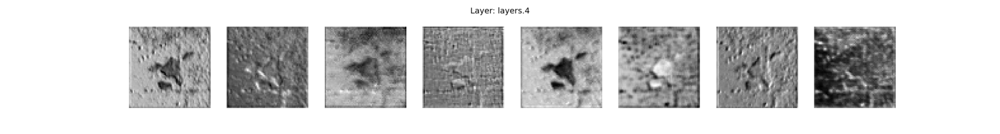

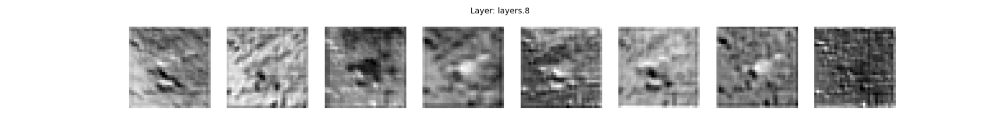

Epoch 15 Train Loss: 0.1063 | Train Acc : 0.9671 | Val Loss : 0.9874 | Val Acc : 0.7098


Epoch 16 Train Loss: 0.1256 | Train Acc : 0.9613 | Val Loss : 0.9547 | Val Acc : 0.7056


Epoch 17 Train Loss: 0.1167 | Train Acc : 0.9621 | Val Loss : 1.1003 | Val Acc : 0.6972


Epoch 18 Train Loss: 0.1259 | Train Acc : 0.9590 | Val Loss : 0.9276 | Val Acc : 0.7256


Epoch 19 Train Loss: 0.1033 | Train Acc : 0.9642 | Val Loss : 1.1587 | Val Acc : 0.6677


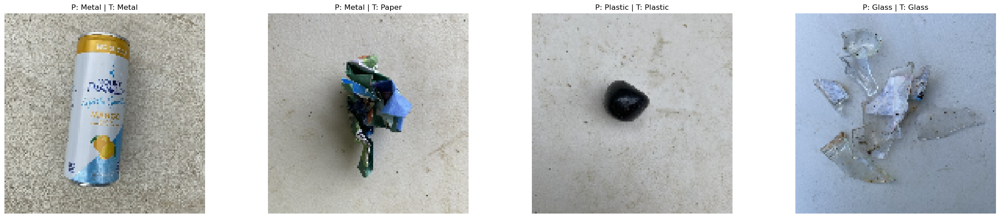

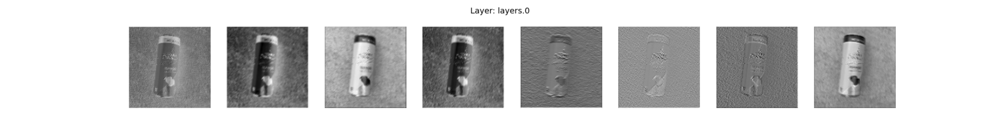

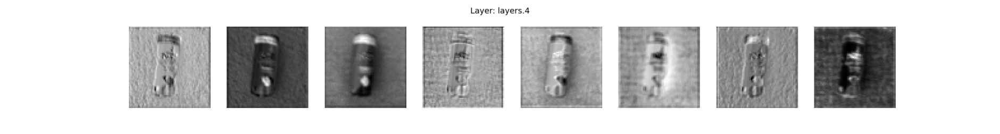

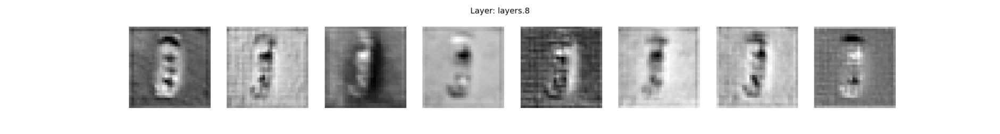

Epoch 20 Train Loss: 0.0952 | Train Acc : 0.9679 | Val Loss : 1.3846 | Val Acc : 0.6488


Epoch 21 Train Loss: 0.0817 | Train Acc : 0.9745 | Val Loss : 1.0583 | Val Acc : 0.6972


Epoch 22 Train Loss: 0.0779 | Train Acc : 0.9753 | Val Loss : 0.9306 | Val Acc : 0.7287


Epoch 23 Train Loss: 0.0651 | Train Acc : 0.9803 | Val Loss : 1.0202 | Val Acc : 0.7150


Epoch 24 Train Loss: 0.0726 | Train Acc : 0.9763 | Val Loss : 1.0785 | Val Acc : 0.6919


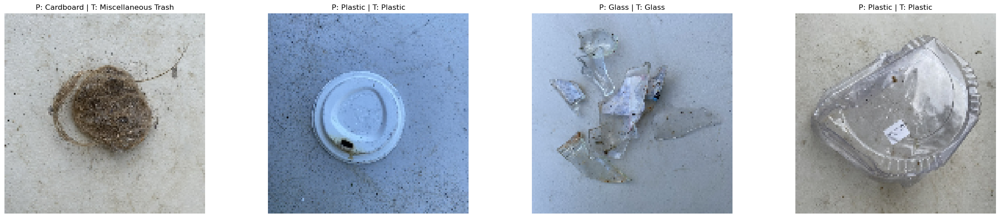

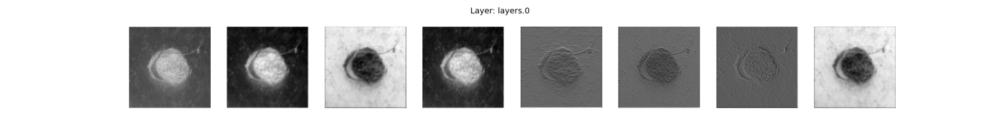

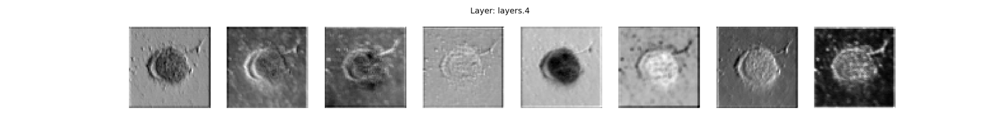

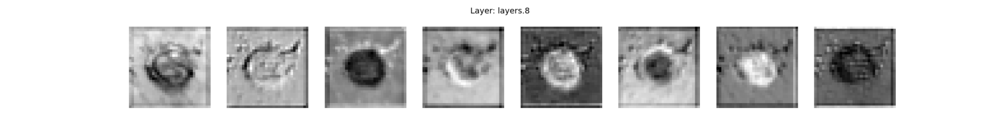

Epoch 25 Train Loss: 0.0605 | Train Acc : 0.9813 | Val Loss : 1.3065 | Val Acc : 0.6877


Epoch 26 Train Loss: 0.0816 | Train Acc : 0.9740 | Val Loss : 1.2552 | Val Acc : 0.6803


Epoch 27 Train Loss: 0.0925 | Train Acc : 0.9692 | Val Loss : 1.5623 | Val Acc : 0.6236


Epoch 28 Train Loss: 0.1014 | Train Acc : 0.9647 | Val Loss : 1.2319 | Val Acc : 0.6803


Epoch 29 Train Loss: 0.0944 | Train Acc : 0.9700 | Val Loss : 1.1693 | Val Acc : 0.7150


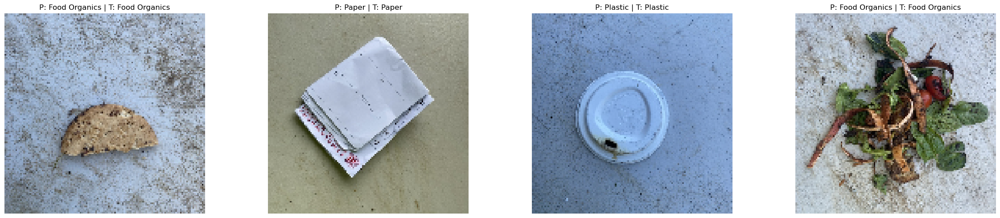

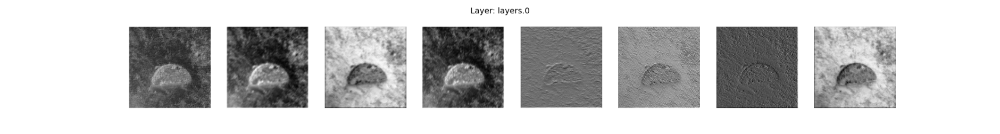

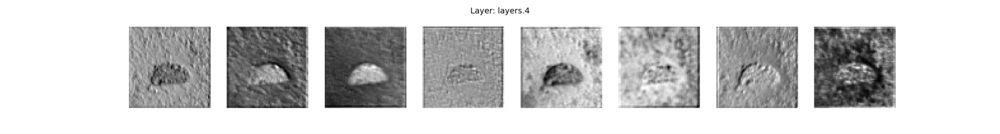

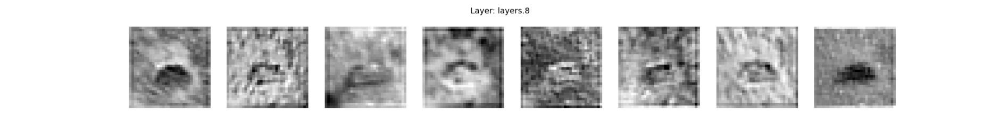

Epoch 30 Train Loss: 0.0896 | Train Acc : 0.9724 | Val Loss : 1.0123 | Val Acc : 0.7287


Epoch 31 Train Loss: 0.0596 | Train Acc : 0.9795 | Val Loss : 1.2238 | Val Acc : 0.6930


Epoch 32 Train Loss: 0.0540 | Train Acc : 0.9805 | Val Loss : 1.1871 | Val Acc : 0.7056


Epoch 33 Train Loss: 0.0553 | Train Acc : 0.9813 | Val Loss : 1.9303 | Val Acc : 0.5657


Epoch 34 Train Loss: 0.0590 | Train Acc : 0.9808 | Val Loss : 1.1435 | Val Acc : 0.7066


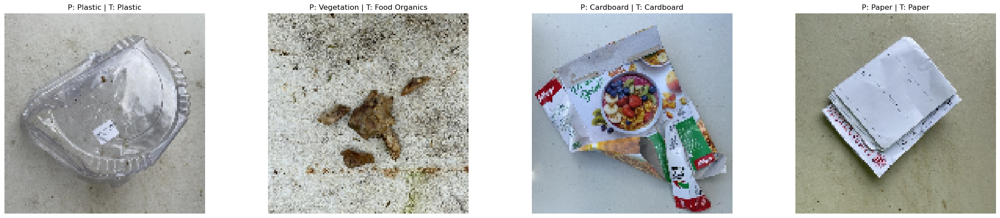

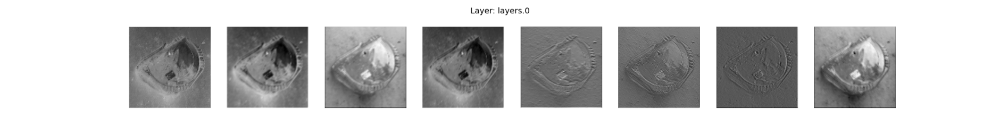

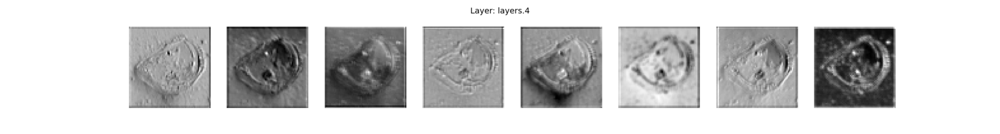

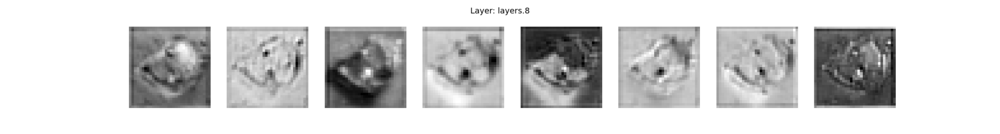

Epoch 35 Train Loss: 0.0711 | Train Acc : 0.9753 | Val Loss : 1.2303 | Val Acc : 0.6835


Epoch 36 Train Loss: 0.0573 | Train Acc : 0.9803 | Val Loss : 1.2274 | Val Acc : 0.6835


Epoch 37 Train Loss: 0.0612 | Train Acc : 0.9821 | Val Loss : 1.4269 | Val Acc : 0.6467


Epoch 38 Train Loss: 0.0607 | Train Acc : 0.9813 | Val Loss : 2.2152 | Val Acc : 0.5342


Epoch 39 Train Loss: 0.0496 | Train Acc : 0.9840 | Val Loss : 1.6859 | Val Acc : 0.6267


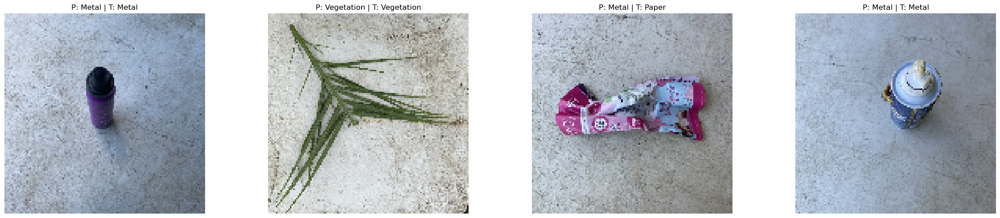

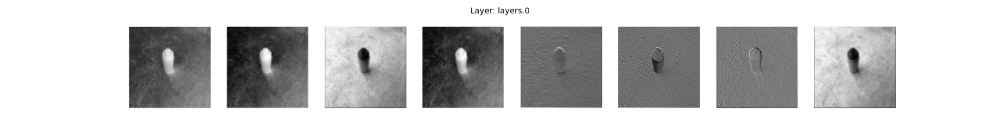

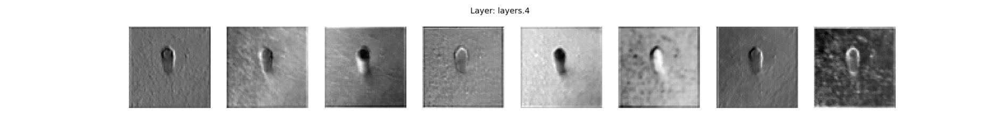

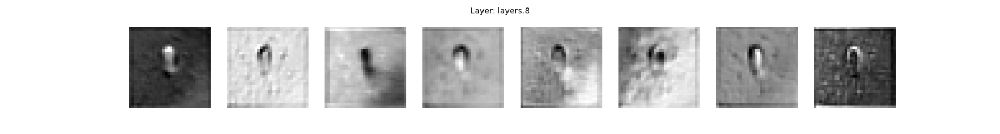

Epoch 40 Train Loss: 0.0558 | Train Acc : 0.9811 | Val Loss : 1.4258 | Val Acc : 0.6972


In [14]:
for train_loss,train_acc,val_loss,val_acc,fig in trainer.train(epochs=EPOCHS,visualize_every=VIS_EVERY):
    pass

In [15]:
dt = time.time()-start_time
print(f"Training took {dt} seconds")

Training took 436.4536166191101 seconds


In [16]:
cnnmodel.save(os.path.join('trained_model','cnn_model.pt'))

Model saved to trained_model\cnn_model.pt


In [17]:
def plot(datas,labels,xlabel,ylabel,title,figsize=(16,8)):
    plt.figure(figsize=figsize)
    for data,label in zip(datas,labels):
        plt.plot(range(1, len(data)+1), data, label=label)
    plt.xlabel(xlabel)
    plt.ylabel(ylabel)
    plt.title(title)
    plt.legend()
    plt.show()

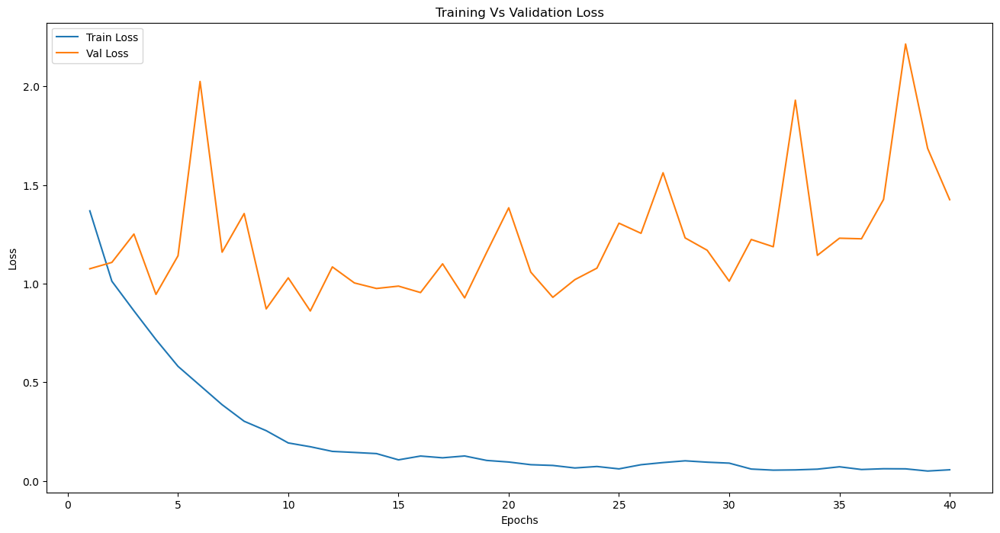

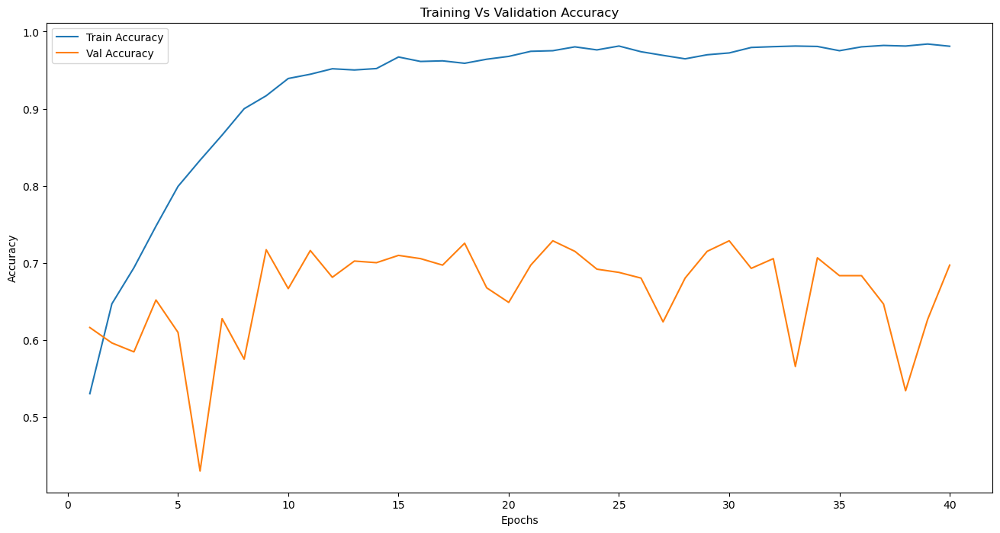

In [18]:
plot([train_loss,val_loss],['Train Loss','Val Loss'],'Epochs','Loss','Training Vs Validation Loss')
plot([train_acc,val_acc],['Train Accuracy','Val Accuracy'],'Epochs','Accuracy','Training Vs Validation Accuracy')

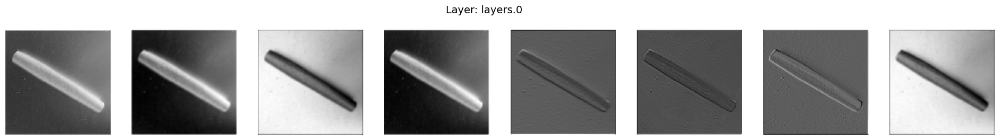

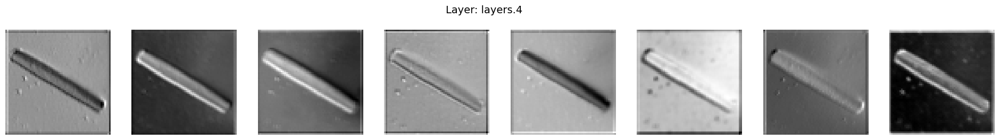

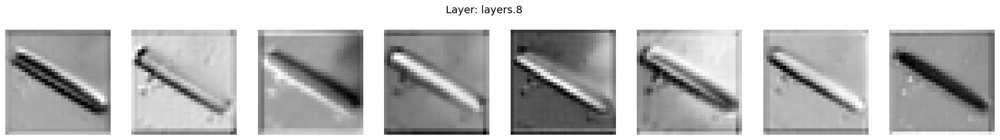

In [19]:
_ = cnnmodel.backbone.visualize(img)

In [34]:
classical_config = Config()
classical_config=config
classical_config.classical_downsample=0 # This is to adjust the amount of downsampling

In [35]:
classical = ClassicalFeatureExtractor(classical_config)

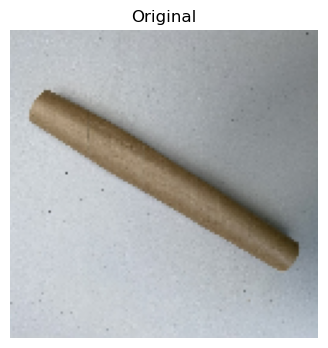

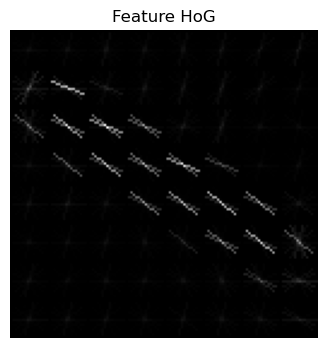

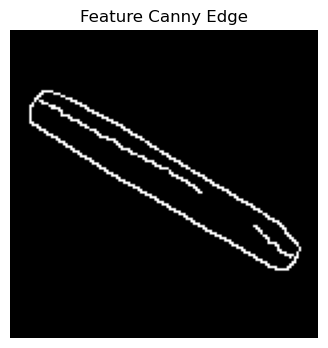

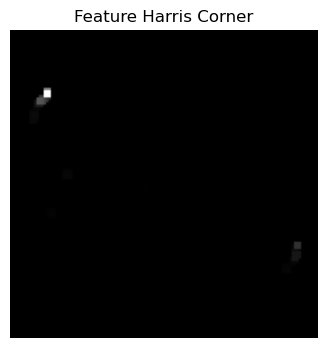

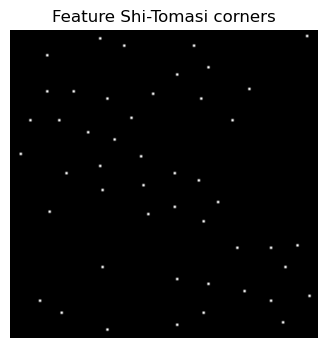

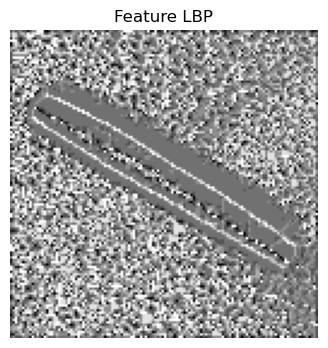

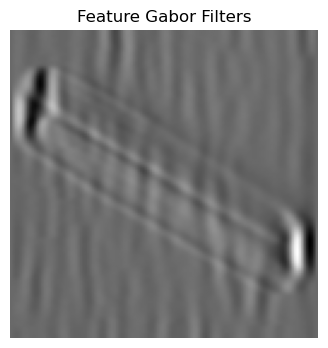

In [36]:
_ =classical.visualize(img)

In [37]:
classic_model = Classifier(classical,train_dataset.dataset.classes,classical_config).to(device)

In [38]:
classic_trainer = ModelTrainer(classic_model,train_dataset,val_dataset,batch_size=BATCH_SIZE,lr=1e-3,device=device,seed=SEED)

In [39]:
start_time = time.time()

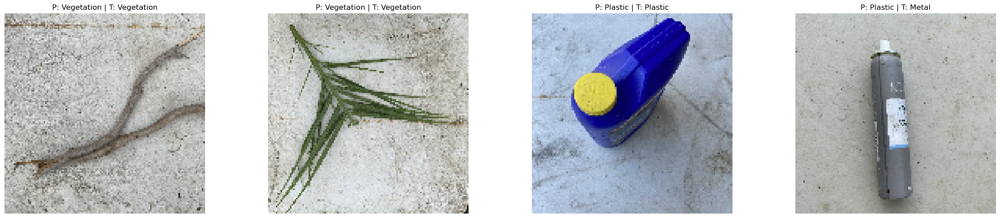

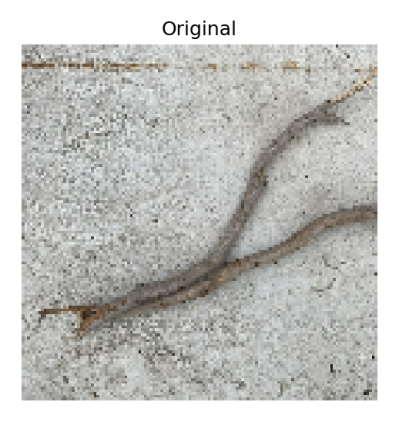

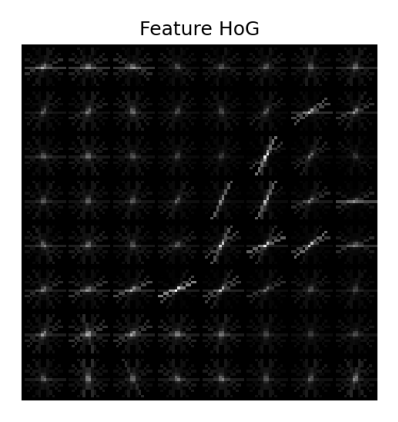

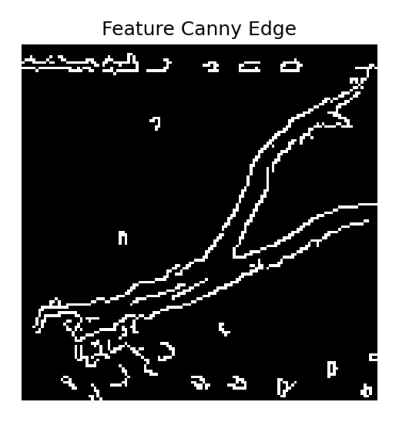

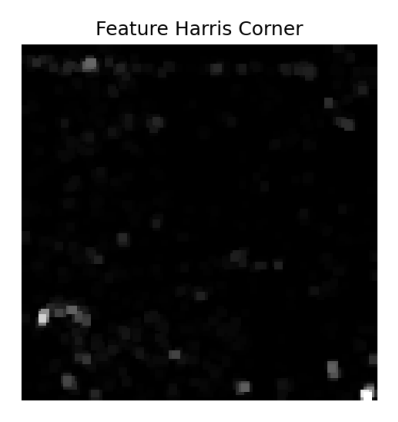

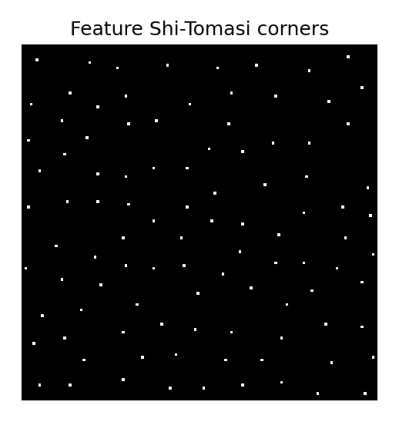

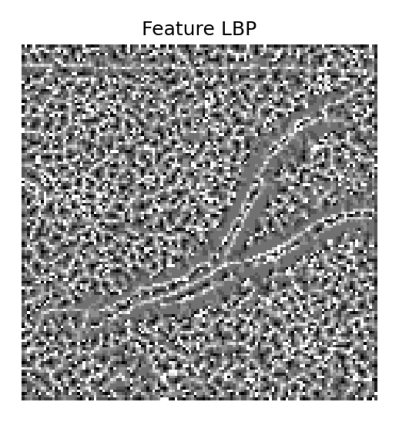

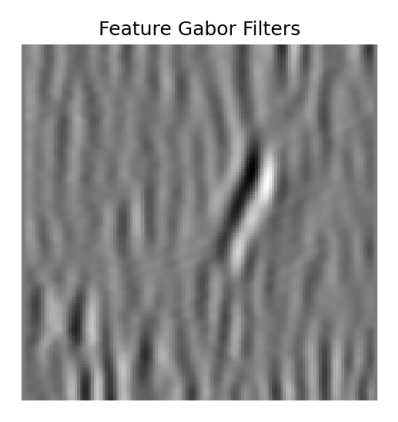

Epoch 1 Train Loss: 1.6898 | Train Acc : 0.3970 | Val Loss : 1.5177 | Val Acc : 0.4458


Epoch 2 Train Loss: 1.2820 | Train Acc : 0.5580 | Val Loss : 1.7332 | Val Acc : 0.3491


Epoch 3 Train Loss: 0.8545 | Train Acc : 0.7264 | Val Loss : 1.6411 | Val Acc : 0.4143


Epoch 4 Train Loss: 0.4926 | Train Acc : 0.8582 | Val Loss : 2.2176 | Val Acc : 0.3396


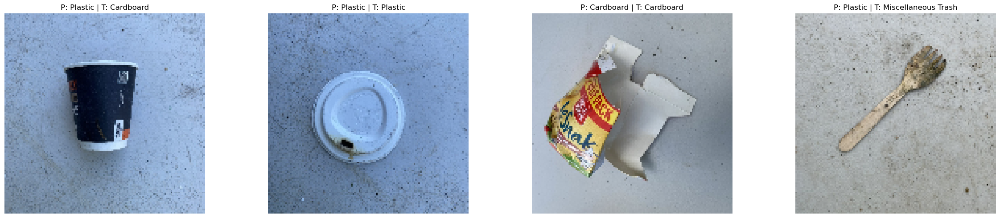

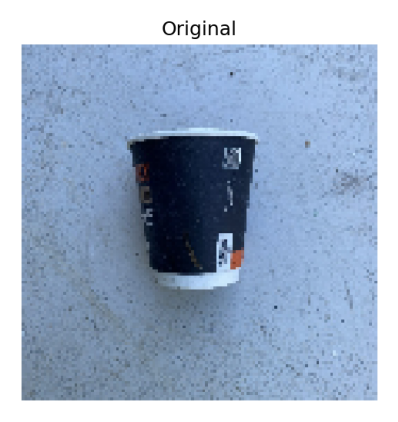

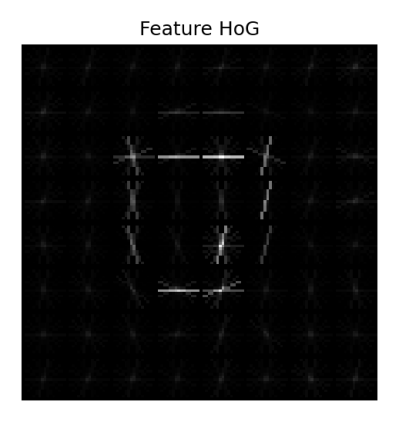

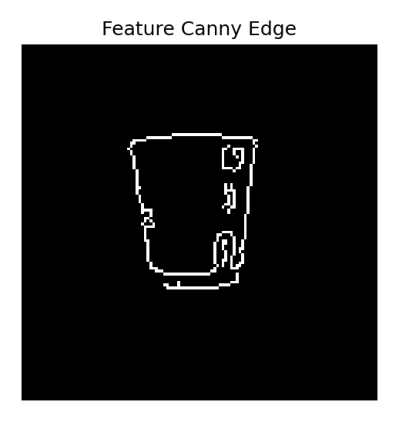

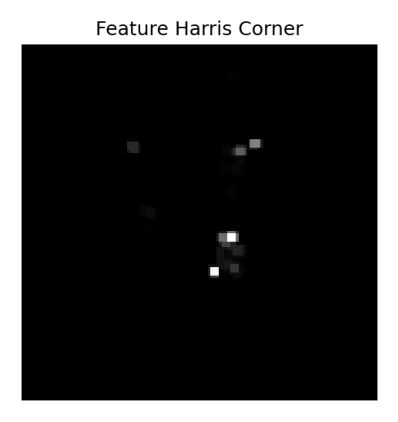

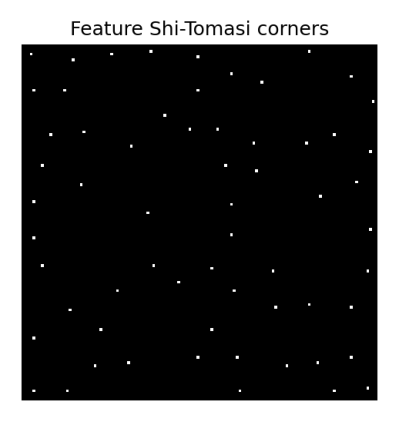

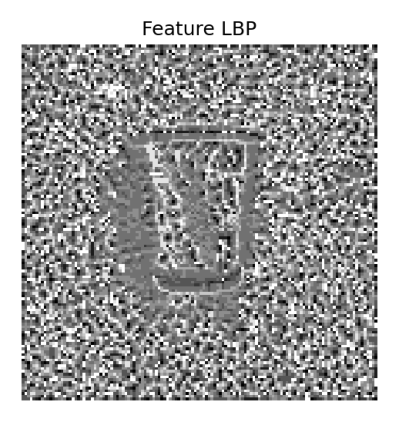

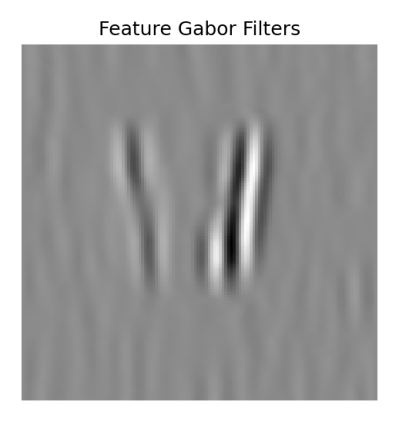

Epoch 5 Train Loss: 0.3028 | Train Acc : 0.9095 | Val Loss : 1.9892 | Val Acc : 0.4332


Epoch 6 Train Loss: 0.2348 | Train Acc : 0.9303 | Val Loss : 2.5243 | Val Acc : 0.3449


Epoch 7 Train Loss: 0.1995 | Train Acc : 0.9366 | Val Loss : 2.7075 | Val Acc : 0.4101


Epoch 8 Train Loss: 0.1712 | Train Acc : 0.9492 | Val Loss : 2.2542 | Val Acc : 0.4280


Epoch 9 Train Loss: 0.1663 | Train Acc : 0.9471 | Val Loss : 2.1745 | Val Acc : 0.4038


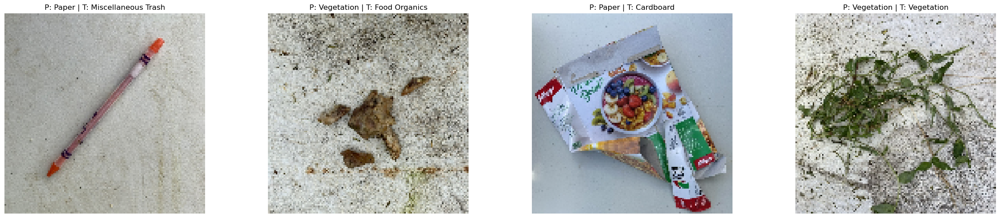

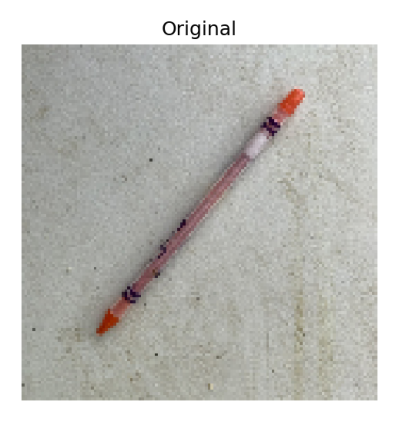

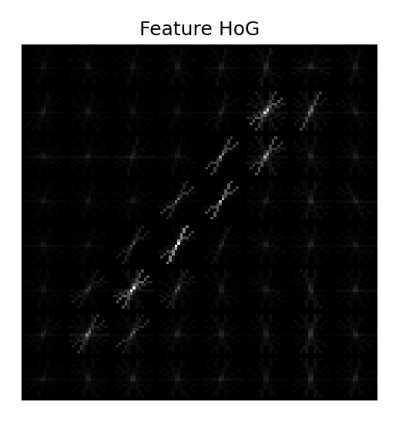

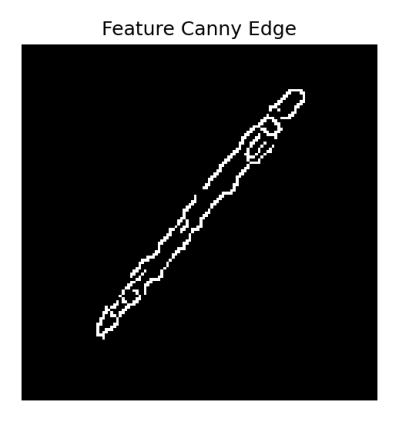

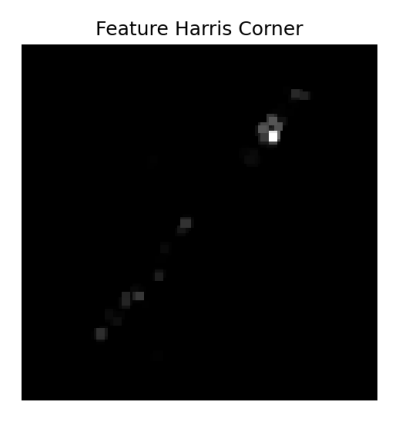

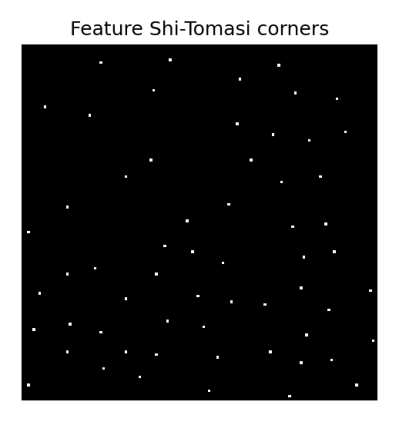

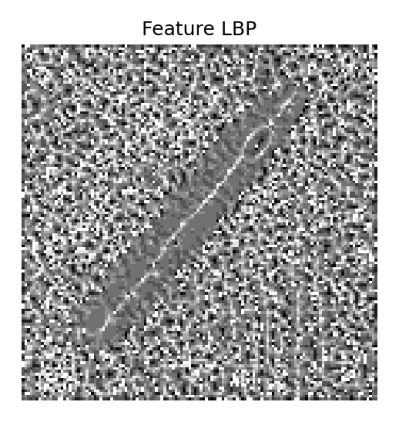

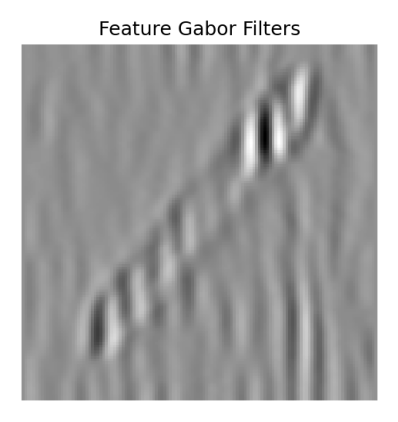

Epoch 10 Train Loss: 0.1721 | Train Acc : 0.9463 | Val Loss : 3.3469 | Val Acc : 0.3228


Epoch 11 Train Loss: 0.1632 | Train Acc : 0.9461 | Val Loss : 3.3027 | Val Acc : 0.3649


Epoch 12 Train Loss: 0.1758 | Train Acc : 0.9387 | Val Loss : 2.5764 | Val Acc : 0.3849


Epoch 13 Train Loss: 0.1805 | Train Acc : 0.9392 | Val Loss : 2.5747 | Val Acc : 0.4353


Epoch 14 Train Loss: 0.1401 | Train Acc : 0.9558 | Val Loss : 3.3604 | Val Acc : 0.3396


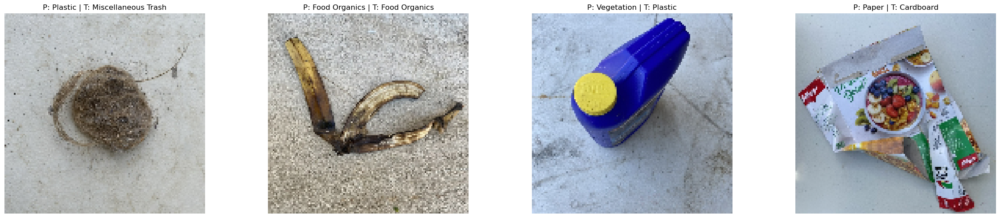

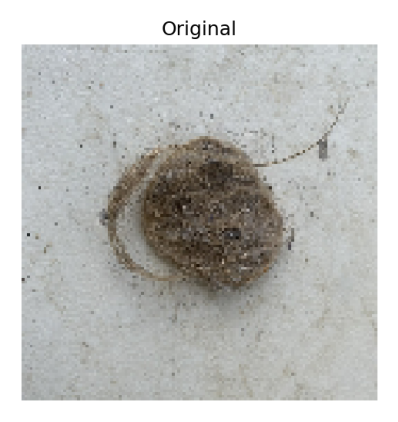

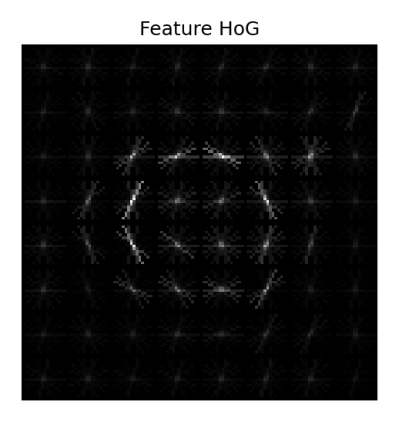

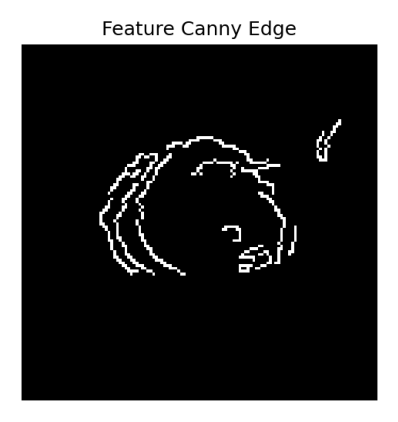

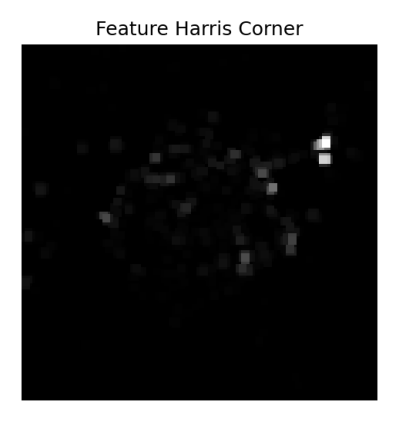

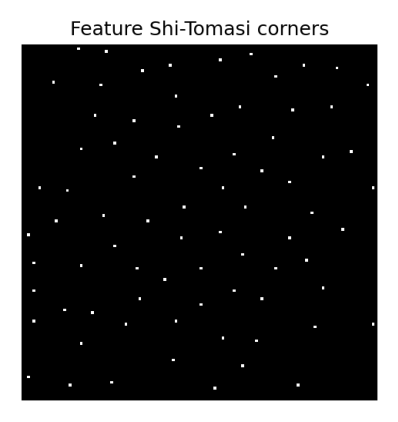

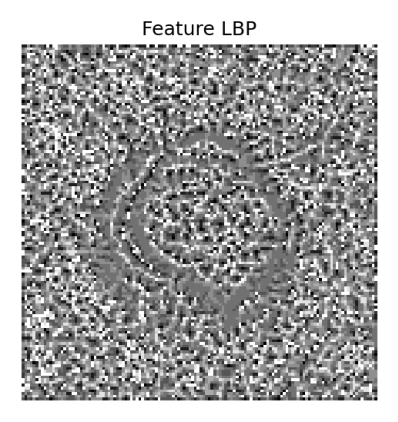

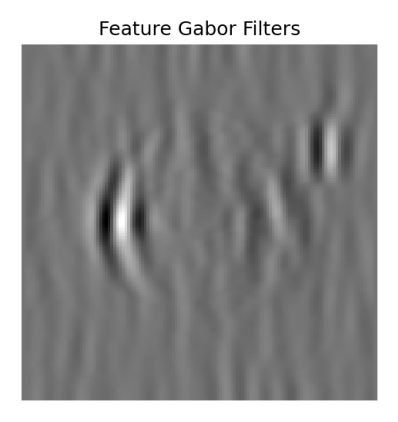

Epoch 15 Train Loss: 0.1332 | Train Acc : 0.9584 | Val Loss : 2.4931 | Val Acc : 0.3954


Epoch 16 Train Loss: 0.1354 | Train Acc : 0.9524 | Val Loss : 2.6998 | Val Acc : 0.4238


Epoch 17 Train Loss: 0.1356 | Train Acc : 0.9526 | Val Loss : 2.5070 | Val Acc : 0.4690


Epoch 18 Train Loss: 0.1574 | Train Acc : 0.9461 | Val Loss : 3.9692 | Val Acc : 0.3028


Epoch 19 Train Loss: 0.1382 | Train Acc : 0.9505 | Val Loss : 2.8613 | Val Acc : 0.4206


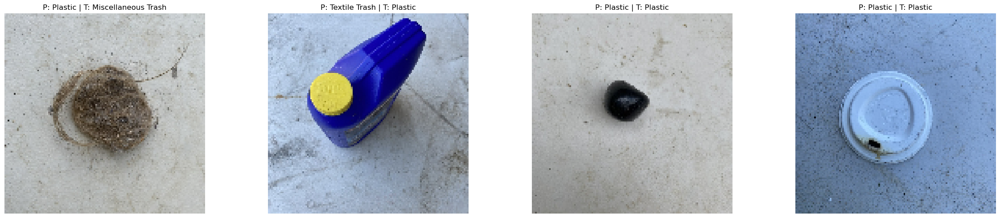

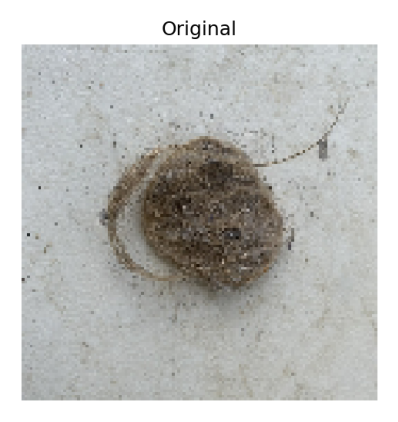

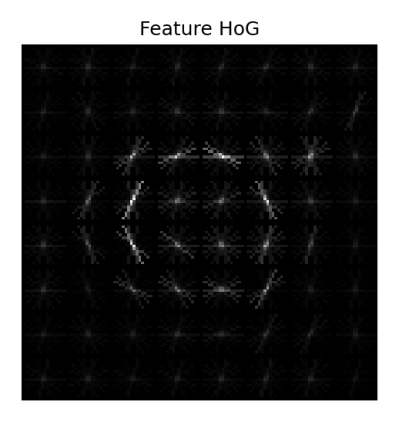

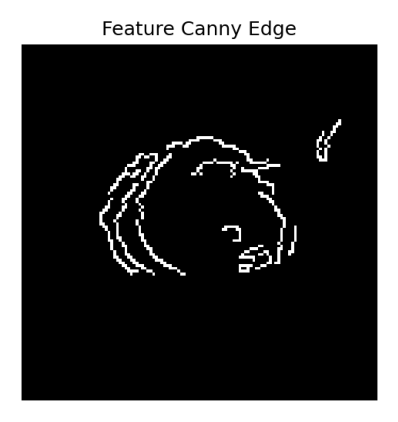

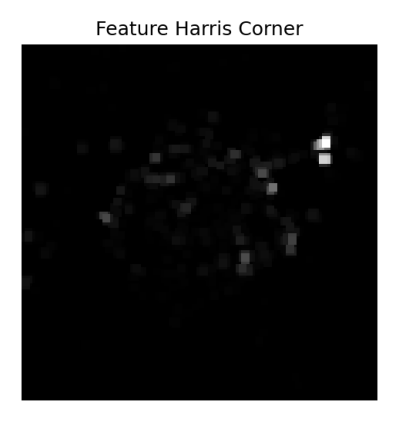

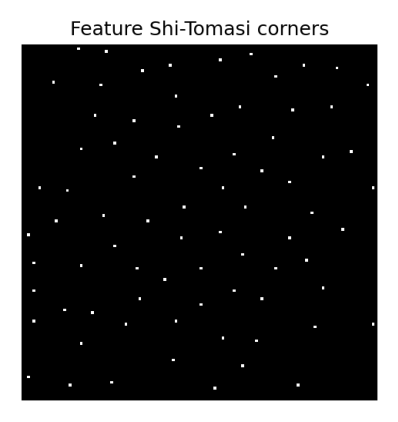

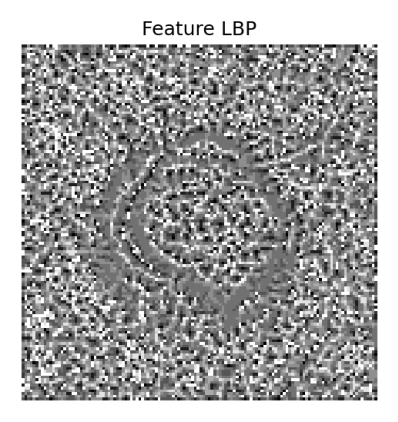

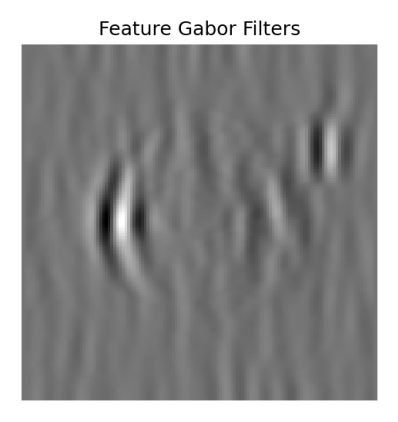

Epoch 20 Train Loss: 0.1627 | Train Acc : 0.9466 | Val Loss : 2.3338 | Val Acc : 0.4479


Epoch 21 Train Loss: 0.1512 | Train Acc : 0.9490 | Val Loss : 2.4748 | Val Acc : 0.4574


Epoch 22 Train Loss: 0.1611 | Train Acc : 0.9448 | Val Loss : 2.2872 | Val Acc : 0.4658


Epoch 23 Train Loss: 0.1123 | Train Acc : 0.9616 | Val Loss : 2.8453 | Val Acc : 0.4227


Epoch 24 Train Loss: 0.1100 | Train Acc : 0.9605 | Val Loss : 3.1252 | Val Acc : 0.3691


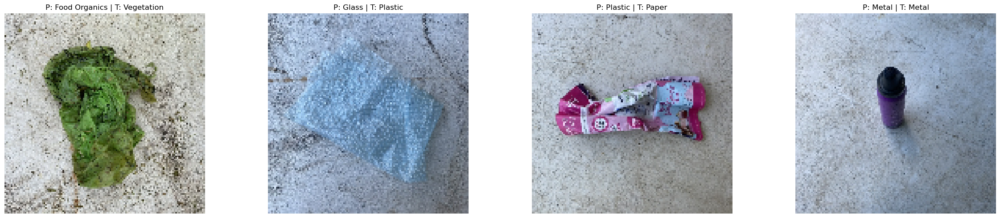

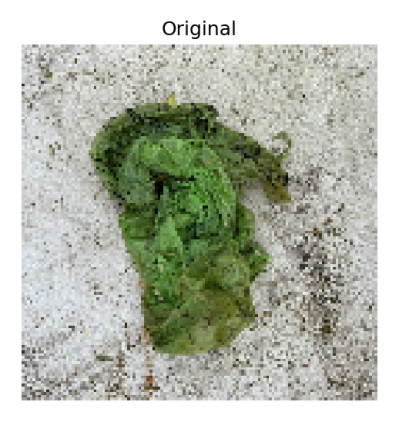

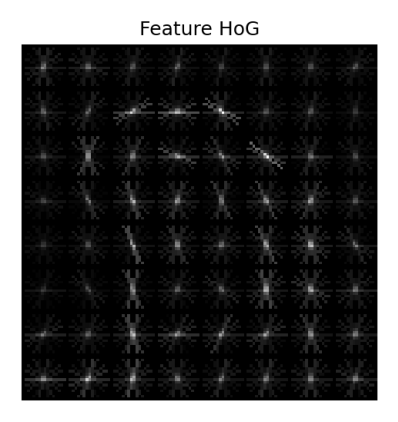

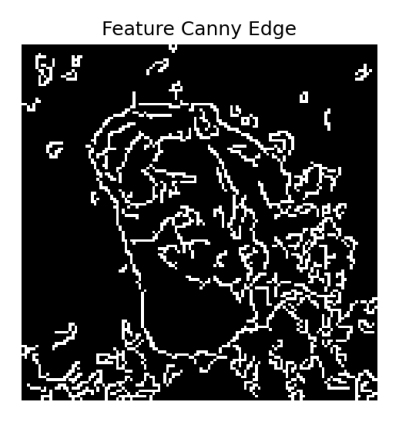

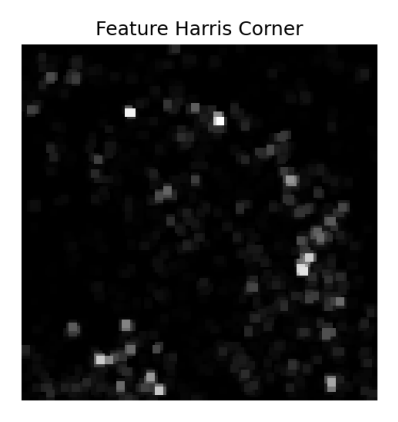

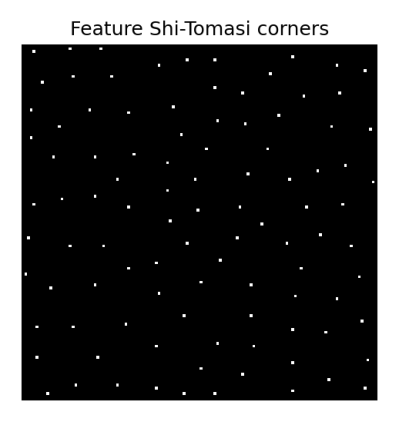

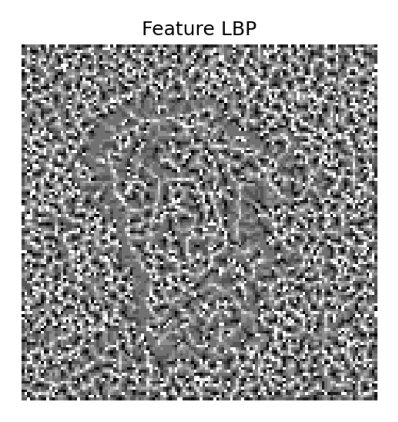

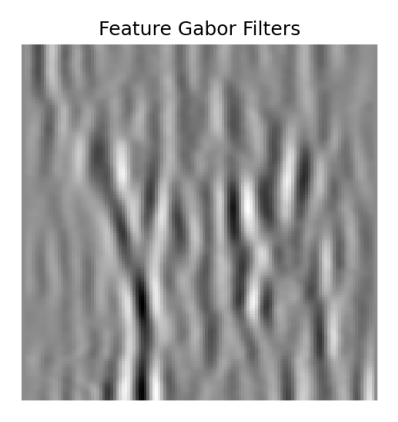

Epoch 25 Train Loss: 0.1266 | Train Acc : 0.9558 | Val Loss : 2.5465 | Val Acc : 0.4627


Epoch 26 Train Loss: 0.1554 | Train Acc : 0.9479 | Val Loss : 4.0586 | Val Acc : 0.3260


Epoch 27 Train Loss: 0.1374 | Train Acc : 0.9529 | Val Loss : 2.8591 | Val Acc : 0.4374


Epoch 28 Train Loss: 0.1468 | Train Acc : 0.9498 | Val Loss : 2.5658 | Val Acc : 0.4175


Epoch 29 Train Loss: 0.1553 | Train Acc : 0.9479 | Val Loss : 3.2251 | Val Acc : 0.4406


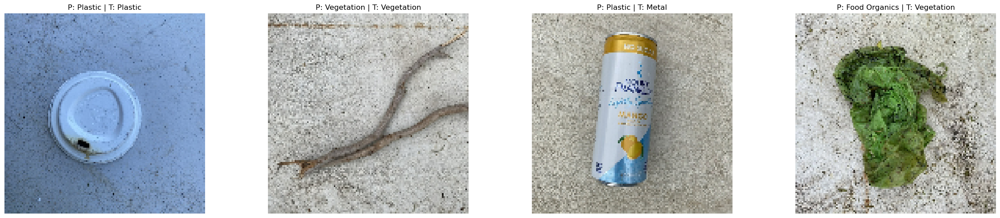

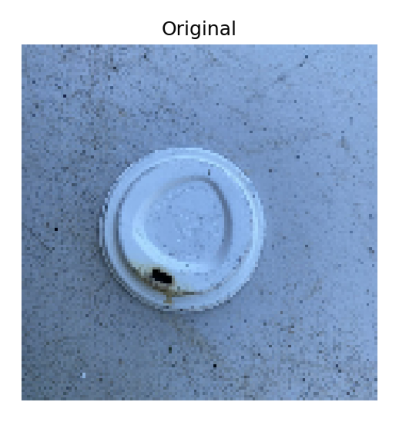

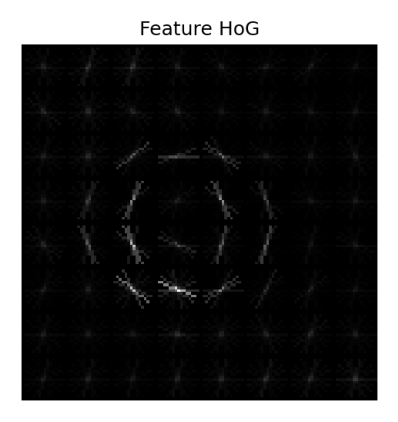

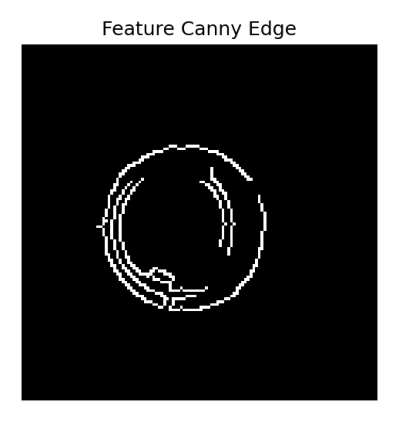

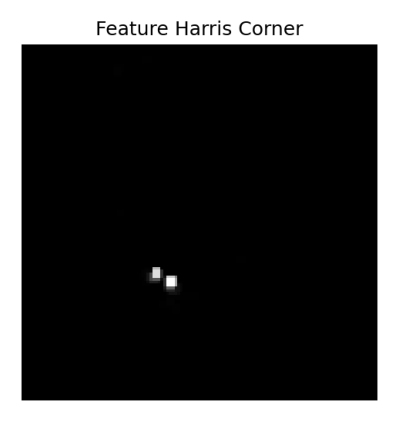

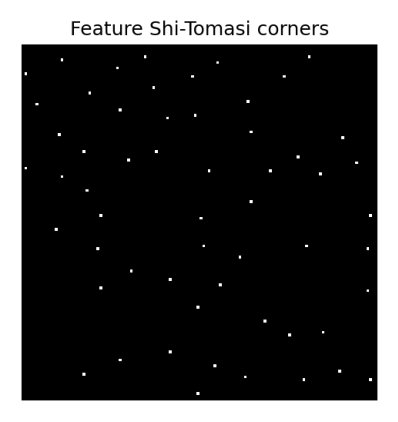

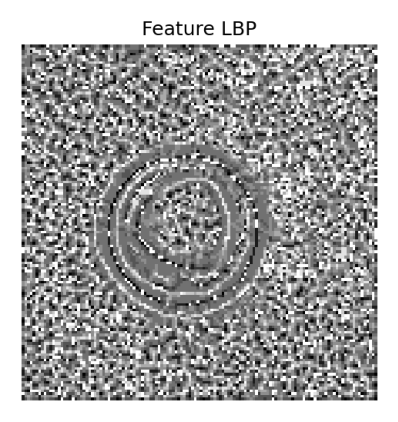

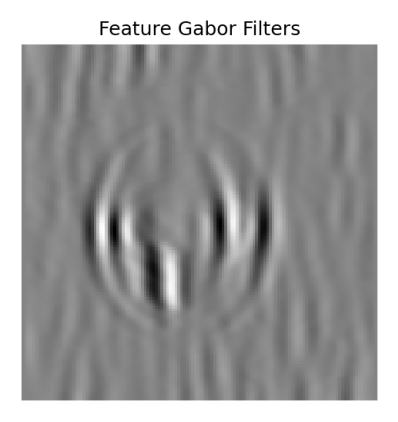

Epoch 30 Train Loss: 0.1059 | Train Acc : 0.9682 | Val Loss : 2.8427 | Val Acc : 0.4406


Epoch 31 Train Loss: 0.1166 | Train Acc : 0.9600 | Val Loss : 2.7227 | Val Acc : 0.4301


Epoch 32 Train Loss: 0.1067 | Train Acc : 0.9655 | Val Loss : 2.3746 | Val Acc : 0.4564


Epoch 33 Train Loss: 0.1283 | Train Acc : 0.9534 | Val Loss : 3.4126 | Val Acc : 0.4374


Epoch 34 Train Loss: 0.1133 | Train Acc : 0.9608 | Val Loss : 3.1212 | Val Acc : 0.4374


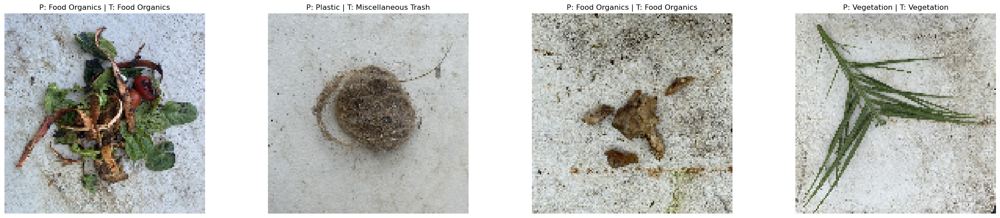

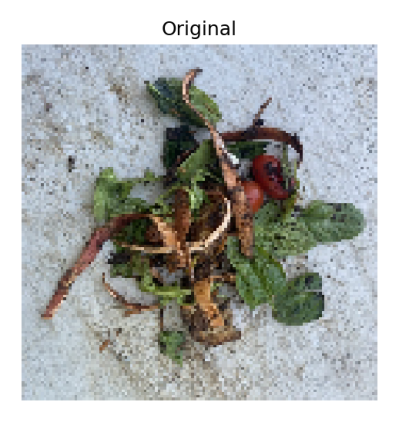

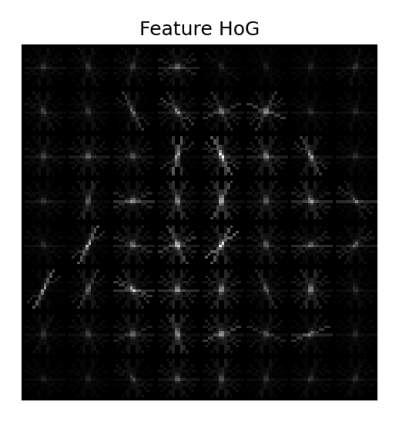

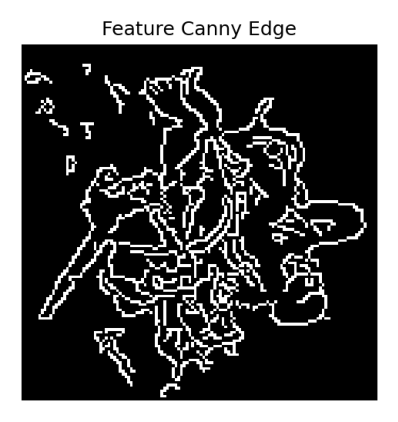

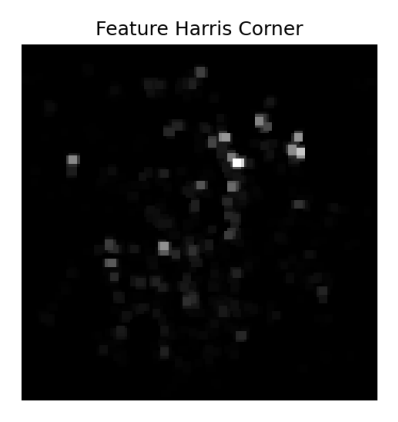

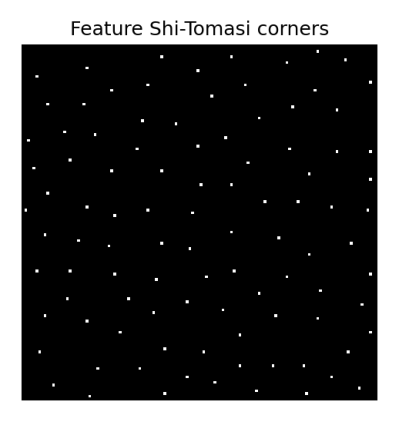

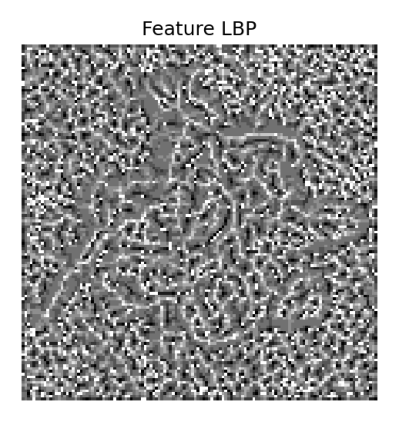

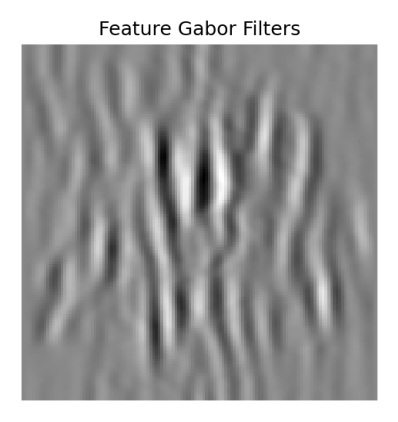

Epoch 35 Train Loss: 0.1263 | Train Acc : 0.9563 | Val Loss : 2.7204 | Val Acc : 0.4795


Epoch 36 Train Loss: 0.1279 | Train Acc : 0.9595 | Val Loss : 3.0965 | Val Acc : 0.4017


Epoch 37 Train Loss: 0.1189 | Train Acc : 0.9611 | Val Loss : 3.2339 | Val Acc : 0.4090


Epoch 38 Train Loss: 0.1375 | Train Acc : 0.9550 | Val Loss : 2.6390 | Val Acc : 0.4606


Epoch 39 Train Loss: 0.1487 | Train Acc : 0.9503 | Val Loss : 3.5297 | Val Acc : 0.3617


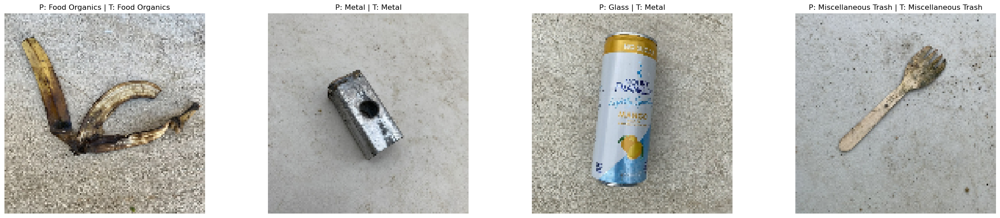

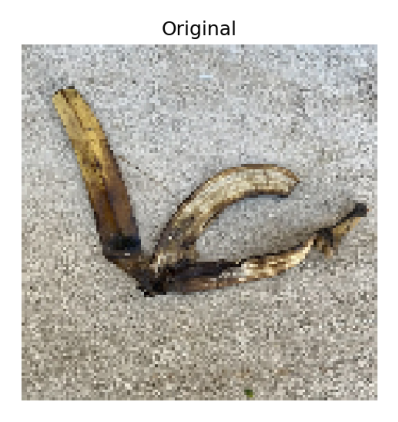

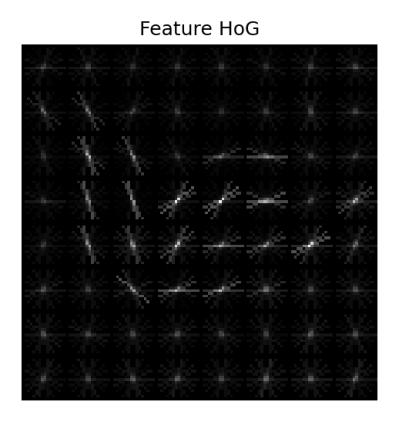

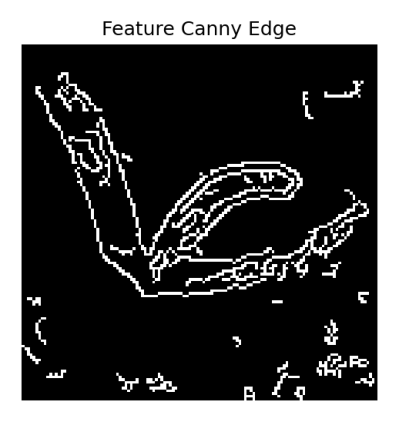

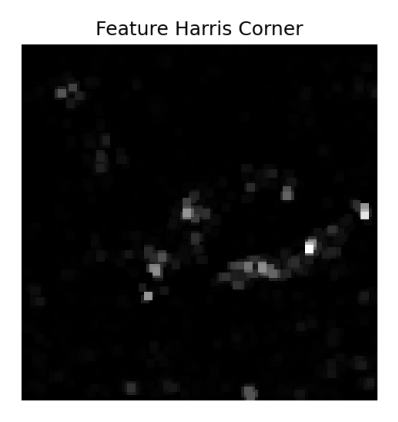

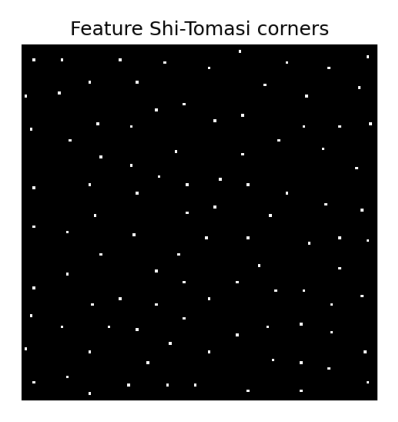

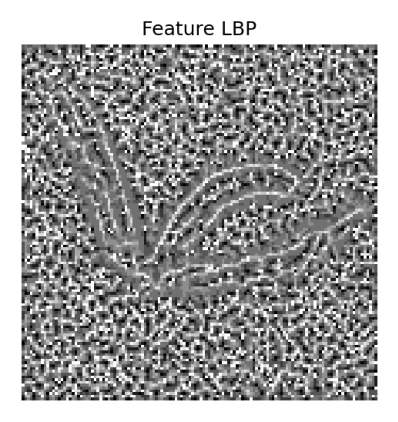

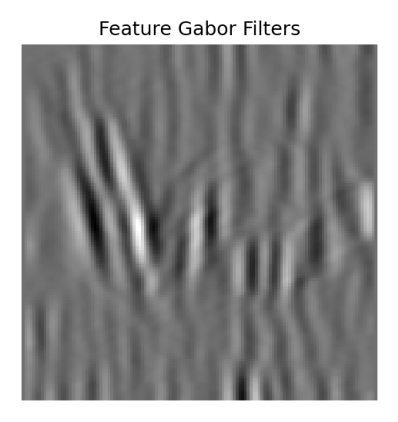

Epoch 40 Train Loss: 0.1297 | Train Acc : 0.9566 | Val Loss : 2.4492 | Val Acc : 0.4700


In [40]:
for train_loss,train_acc,val_loss,val_acc,fig in classic_trainer.train(epochs=EPOCHS,visualize_every=VIS_EVERY):
    pass

In [41]:
dt = time.time()-start_time
print(f"Training took {dt} seconds")

Training took 2094.4255142211914 seconds


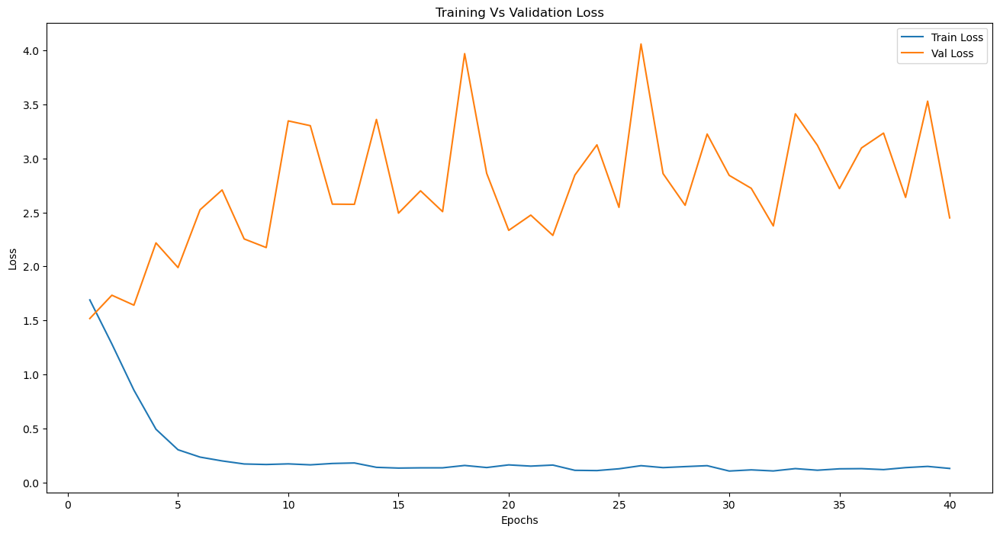

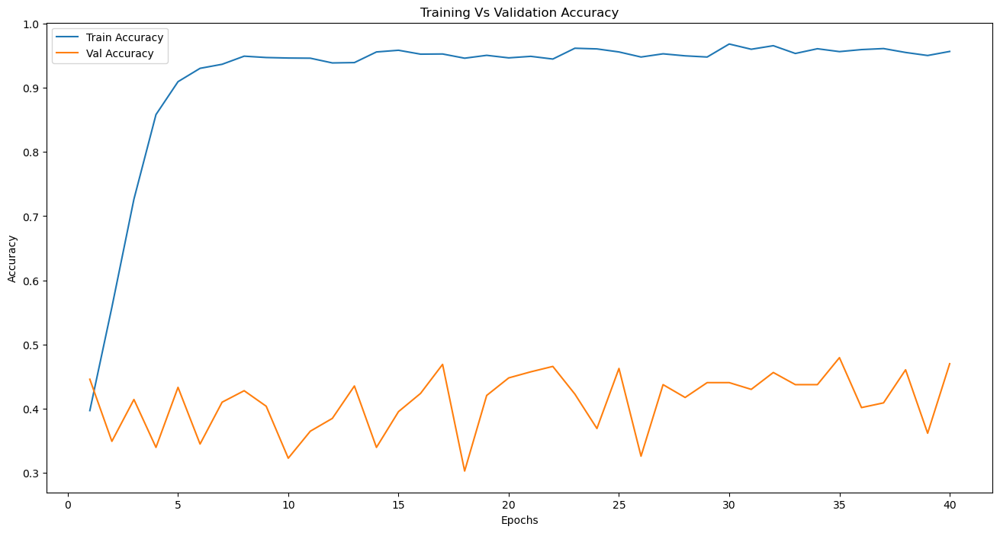

In [42]:
plot([train_loss,val_loss],['Train Loss','Val Loss'],'Epochs','Loss','Training Vs Validation Loss')
plot([train_acc,val_acc],['Train Accuracy','Val Accuracy'],'Epochs','Accuracy','Training Vs Validation Accuracy')

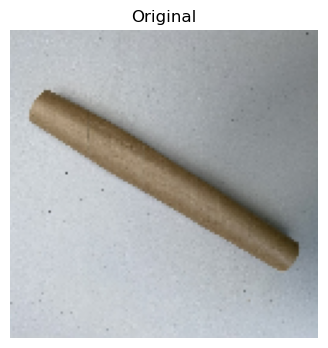

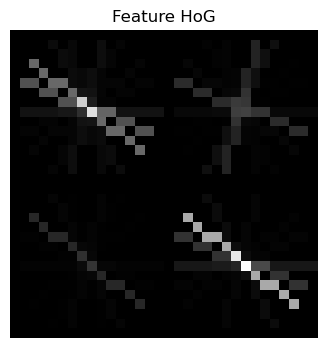

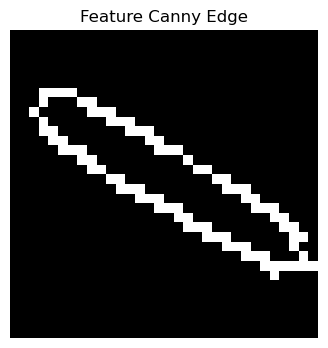

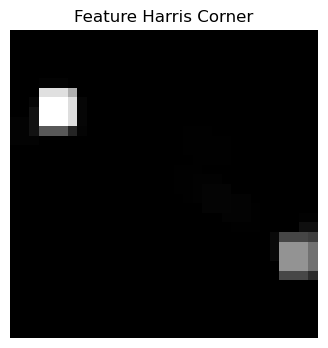

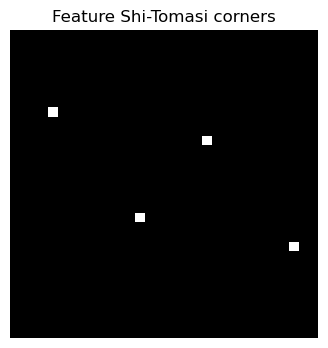

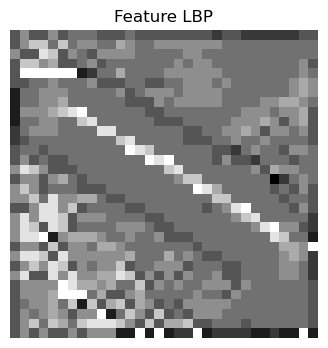

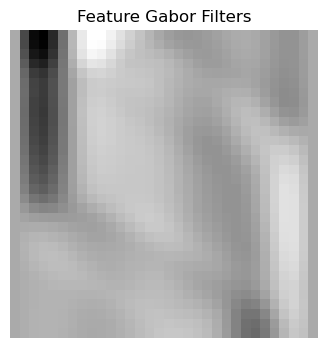

In [43]:
classical_config = Config()
classical_config=config
classical_config.classical_downsample=2
classical = ClassicalFeatureExtractor(classical_config)
classic_model = Classifier(classical,train_dataset.dataset.classes,classical_config).to(device)
_ =classical.visualize(img)

In [44]:
classic_trainer = ModelTrainer(classic_model,train_dataset,val_dataset,batch_size=BATCH_SIZE,lr=1e-3,device=device,seed=SEED)

In [45]:
start_time = time.time()

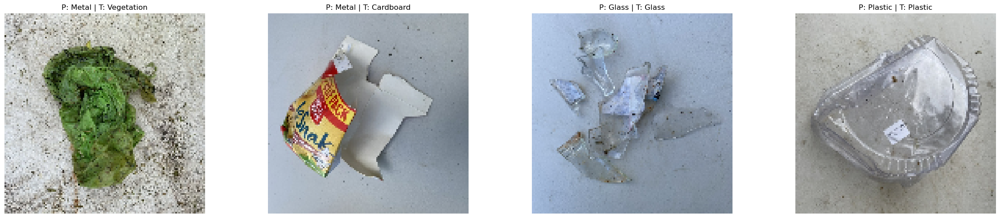

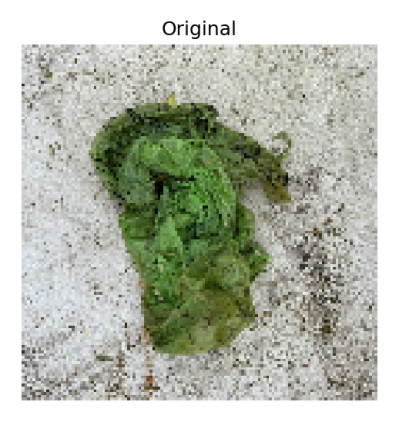

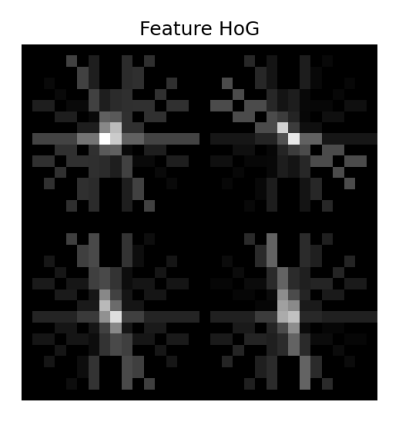

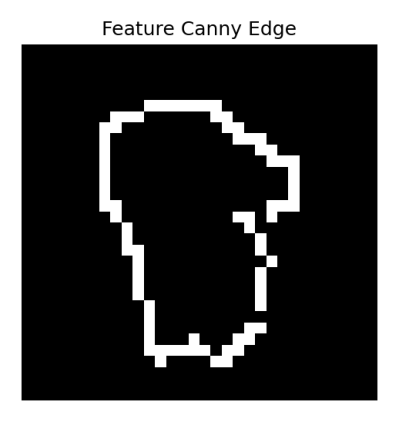

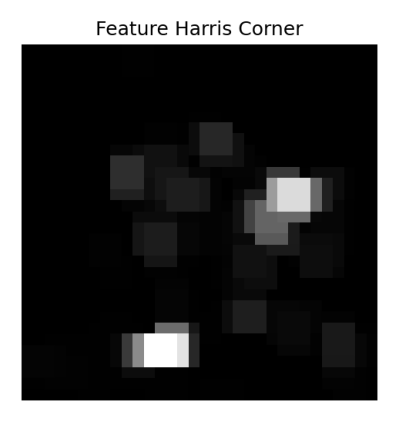

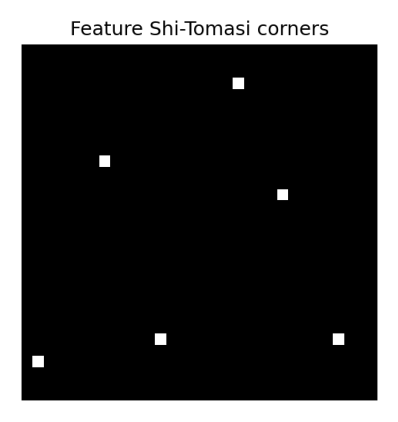

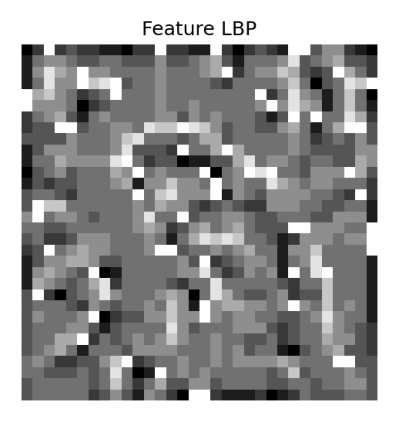

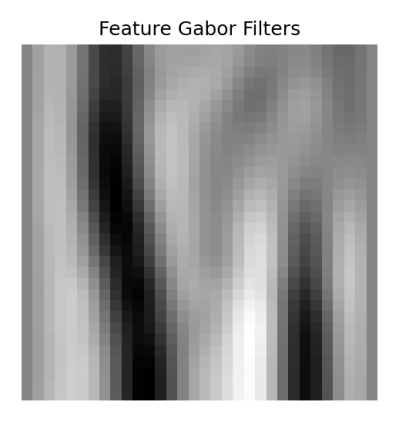

Epoch 1 Train Loss: 1.8501 | Train Acc : 0.3423 | Val Loss : 1.6864 | Val Acc : 0.4080


Epoch 2 Train Loss: 1.5492 | Train Acc : 0.4638 | Val Loss : 1.6603 | Val Acc : 0.4154


Epoch 3 Train Loss: 1.3156 | Train Acc : 0.5451 | Val Loss : 1.6353 | Val Acc : 0.4280


Epoch 4 Train Loss: 1.0873 | Train Acc : 0.6285 | Val Loss : 1.7235 | Val Acc : 0.4427


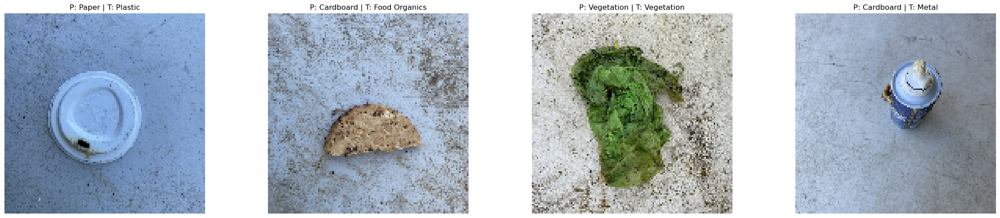

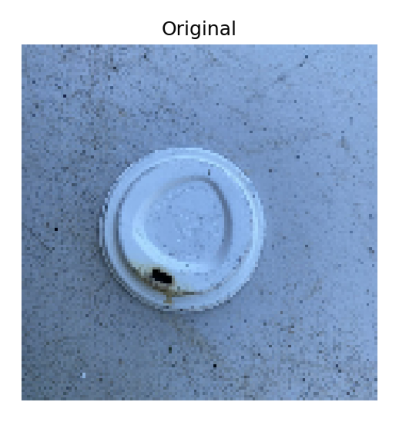

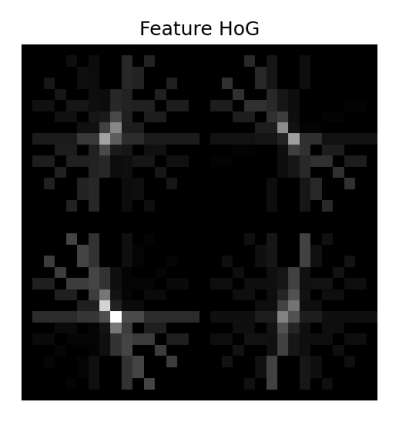

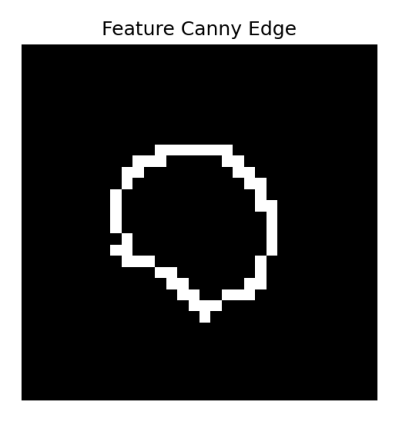

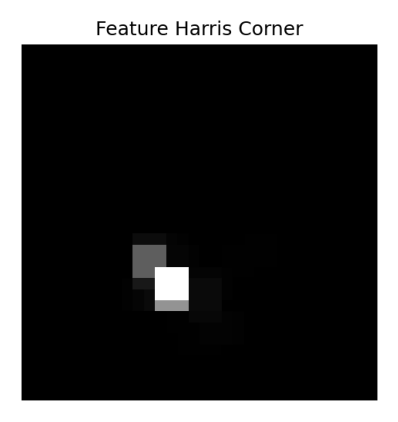

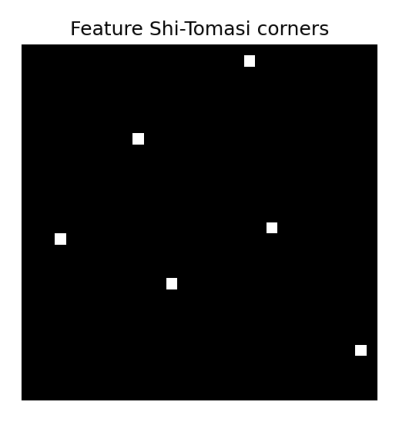

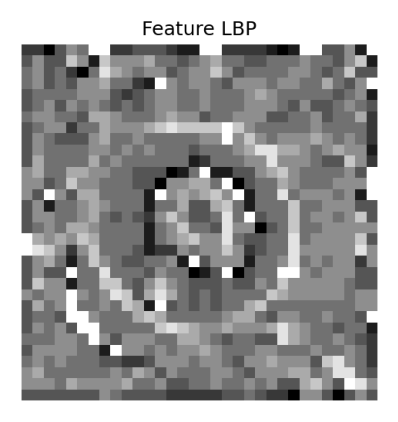

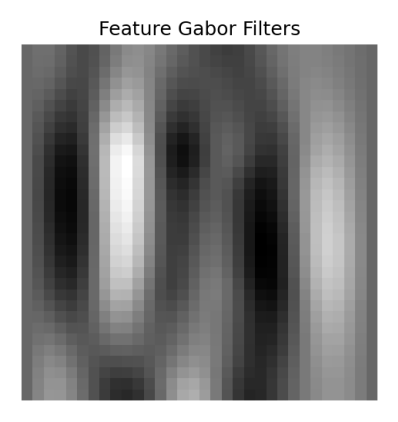

Epoch 5 Train Loss: 0.8952 | Train Acc : 0.7046 | Val Loss : 1.9826 | Val Acc : 0.3659


Epoch 6 Train Loss: 0.7219 | Train Acc : 0.7548 | Val Loss : 1.9605 | Val Acc : 0.4090


Epoch 7 Train Loss: 0.5805 | Train Acc : 0.8082 | Val Loss : 1.9092 | Val Acc : 0.3975


Epoch 8 Train Loss: 0.4391 | Train Acc : 0.8571 | Val Loss : 2.0572 | Val Acc : 0.3901


Epoch 9 Train Loss: 0.3944 | Train Acc : 0.8758 | Val Loss : 2.0690 | Val Acc : 0.4490


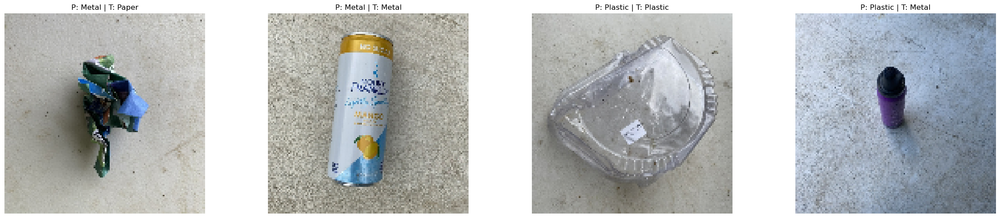

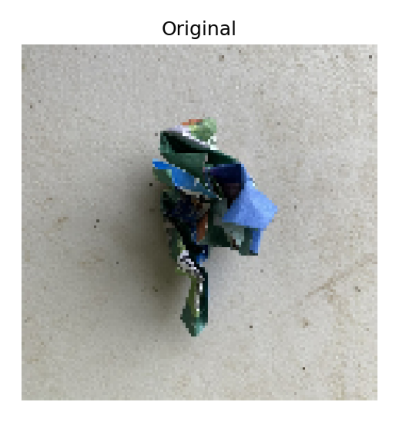

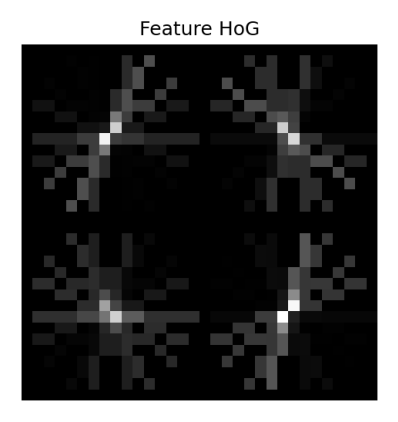

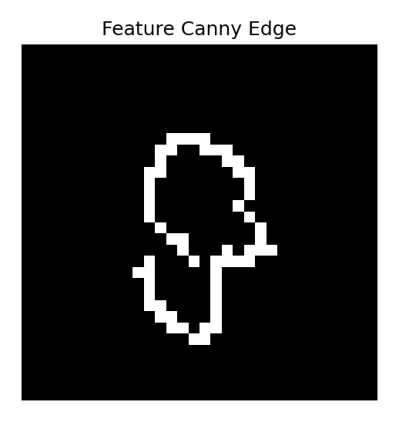

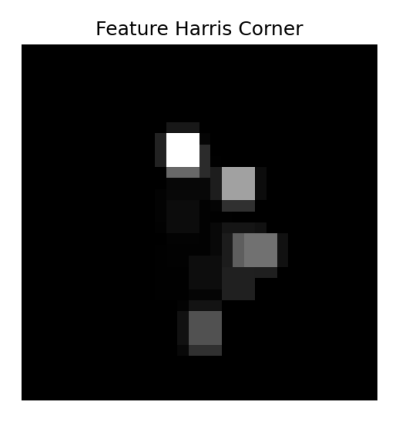

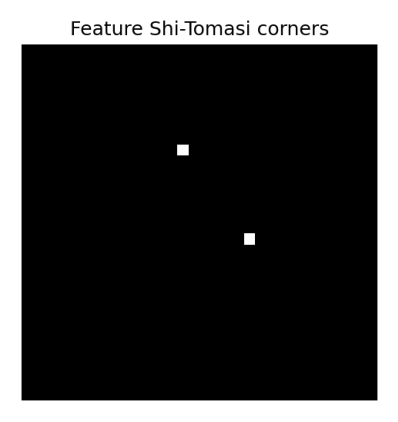

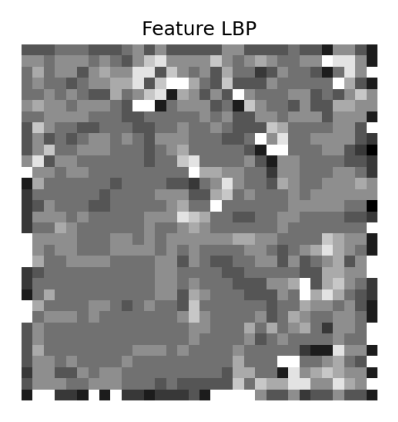

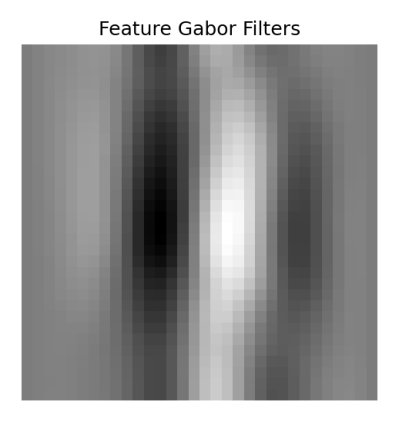

Epoch 10 Train Loss: 0.3327 | Train Acc : 0.8892 | Val Loss : 2.2416 | Val Acc : 0.4280


Epoch 11 Train Loss: 0.3085 | Train Acc : 0.9008 | Val Loss : 2.3429 | Val Acc : 0.4269


Epoch 12 Train Loss: 0.2479 | Train Acc : 0.9203 | Val Loss : 2.1576 | Val Acc : 0.4385


Epoch 13 Train Loss: 0.2517 | Train Acc : 0.9190 | Val Loss : 2.3419 | Val Acc : 0.4248


Epoch 14 Train Loss: 0.2308 | Train Acc : 0.9192 | Val Loss : 2.2612 | Val Acc : 0.4374


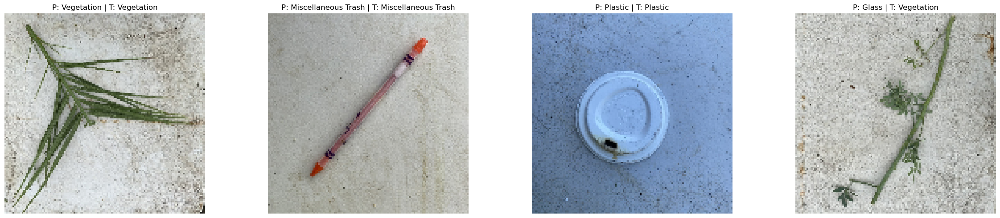

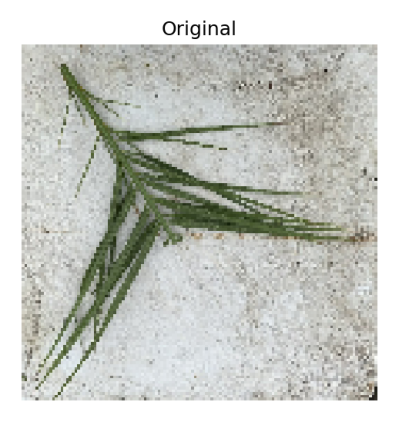

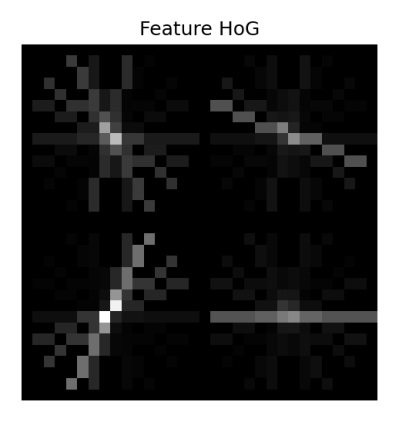

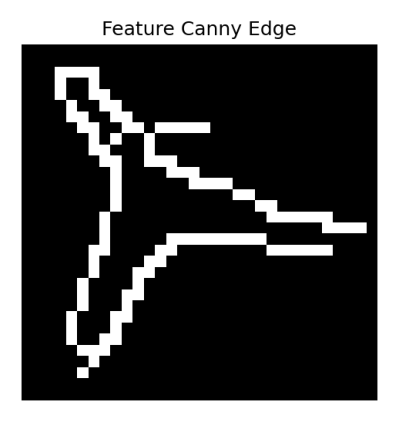

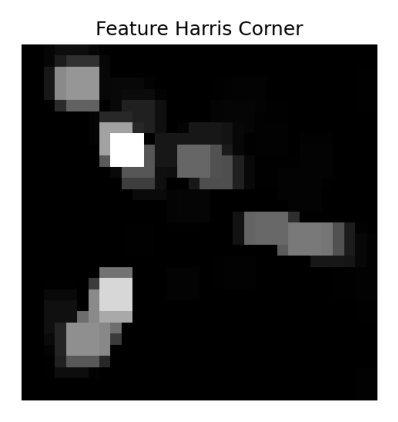

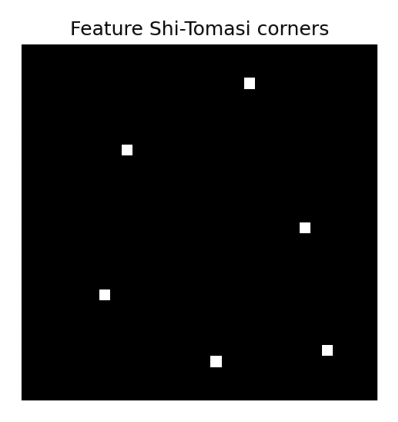

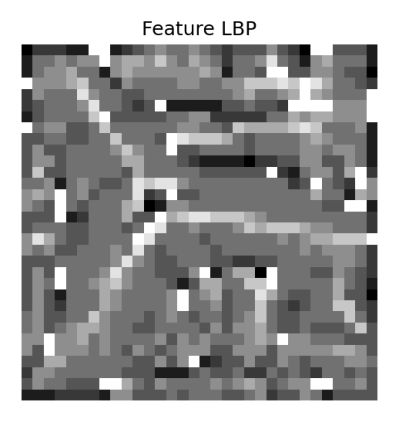

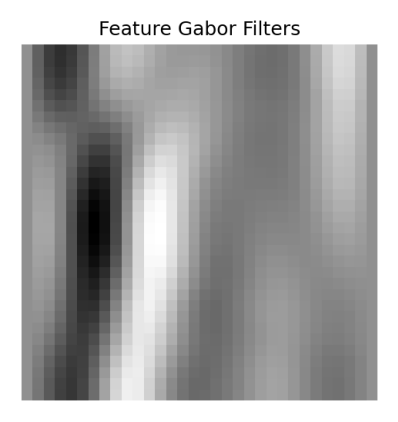

Epoch 15 Train Loss: 0.2010 | Train Acc : 0.9371 | Val Loss : 2.4797 | Val Acc : 0.4364


Epoch 16 Train Loss: 0.1996 | Train Acc : 0.9342 | Val Loss : 2.1638 | Val Acc : 0.4574


Epoch 17 Train Loss: 0.1800 | Train Acc : 0.9363 | Val Loss : 2.5835 | Val Acc : 0.4069


Epoch 18 Train Loss: 0.1783 | Train Acc : 0.9374 | Val Loss : 2.7865 | Val Acc : 0.4259


Epoch 19 Train Loss: 0.1559 | Train Acc : 0.9495 | Val Loss : 2.6635 | Val Acc : 0.4143


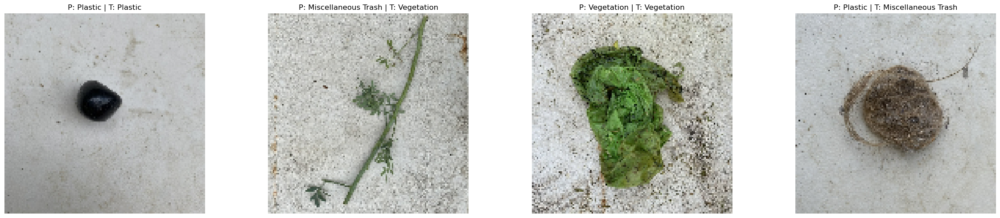

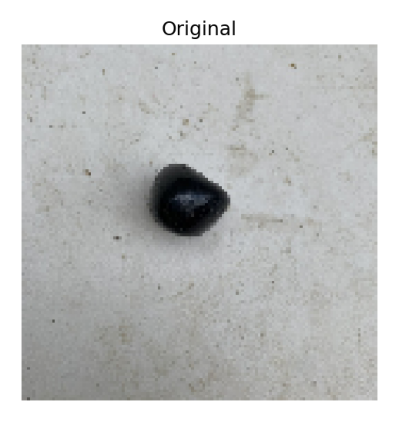

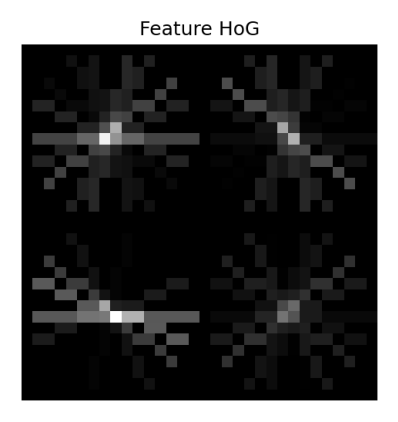

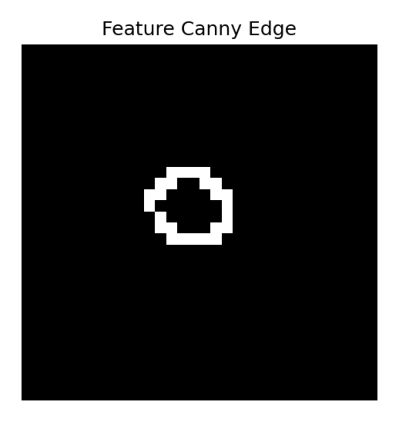

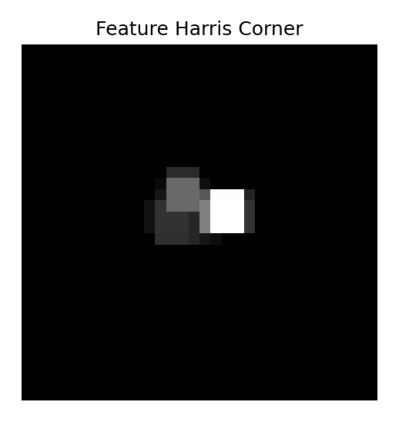

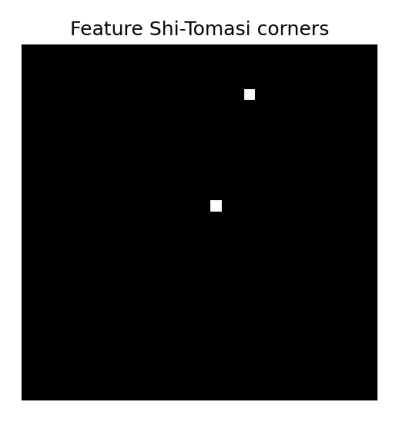

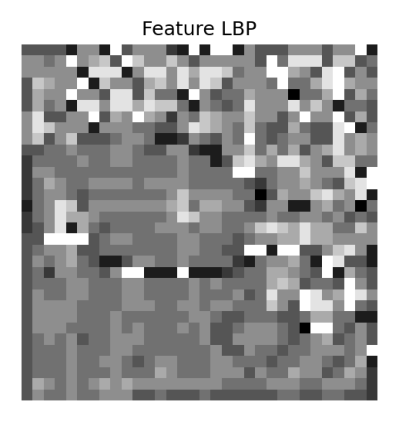

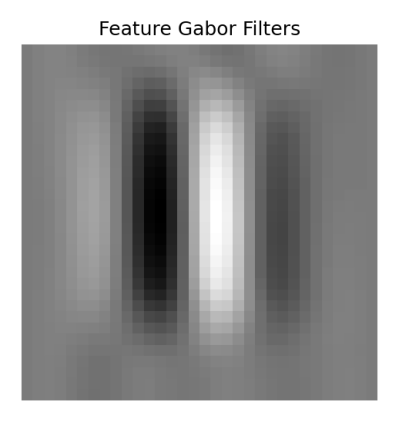

Epoch 20 Train Loss: 0.1418 | Train Acc : 0.9550 | Val Loss : 2.5460 | Val Acc : 0.4311


Epoch 21 Train Loss: 0.1312 | Train Acc : 0.9584 | Val Loss : 2.6291 | Val Acc : 0.4385


Epoch 22 Train Loss: 0.1336 | Train Acc : 0.9547 | Val Loss : 3.0863 | Val Acc : 0.4069


Epoch 23 Train Loss: 0.1435 | Train Acc : 0.9526 | Val Loss : 2.7084 | Val Acc : 0.4311


Epoch 24 Train Loss: 0.1458 | Train Acc : 0.9495 | Val Loss : 2.7723 | Val Acc : 0.4458


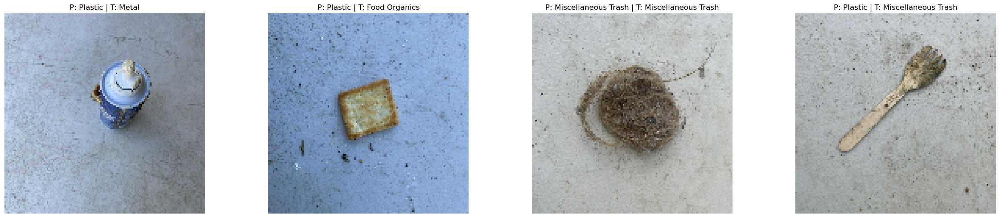

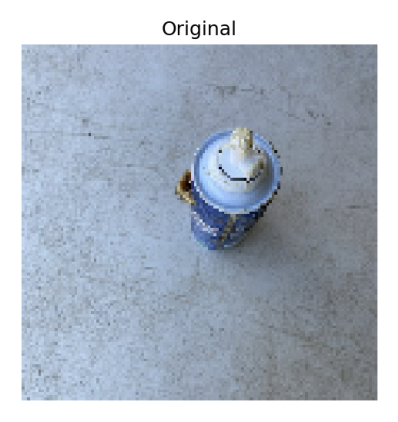

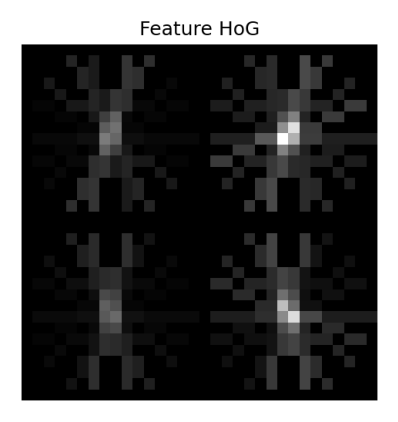

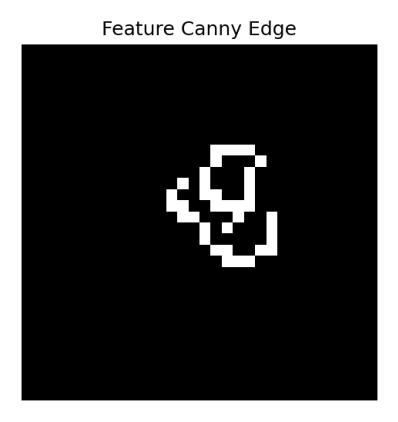

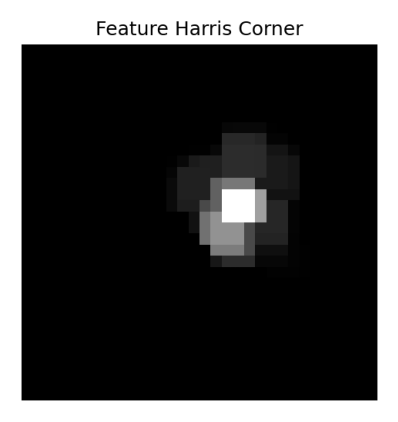

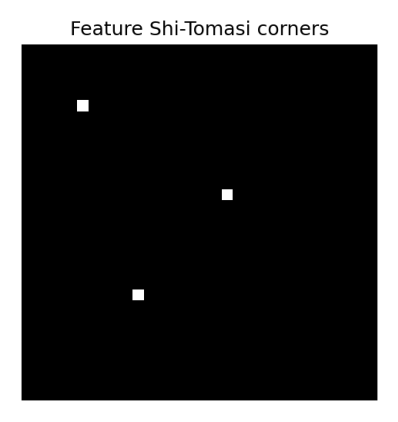

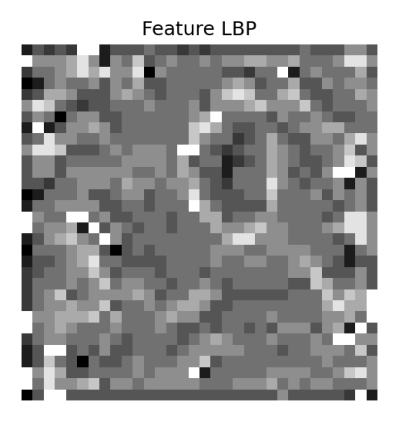

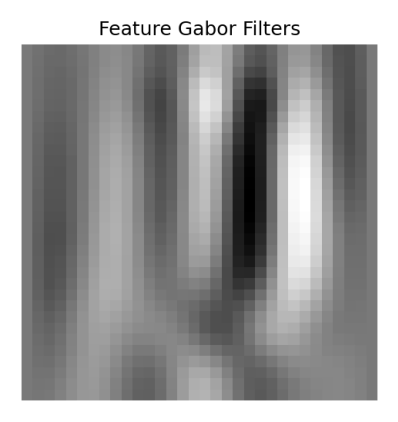

Epoch 25 Train Loss: 0.1560 | Train Acc : 0.9479 | Val Loss : 2.5625 | Val Acc : 0.4543


Epoch 26 Train Loss: 0.1523 | Train Acc : 0.9505 | Val Loss : 2.7088 | Val Acc : 0.4227


Epoch 27 Train Loss: 0.1424 | Train Acc : 0.9466 | Val Loss : 2.8566 | Val Acc : 0.4374


Epoch 28 Train Loss: 0.1478 | Train Acc : 0.9542 | Val Loss : 2.7261 | Val Acc : 0.4469


Epoch 29 Train Loss: 0.1199 | Train Acc : 0.9579 | Val Loss : 2.8213 | Val Acc : 0.4343


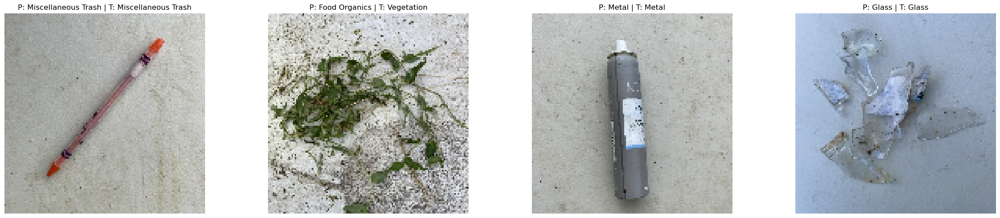

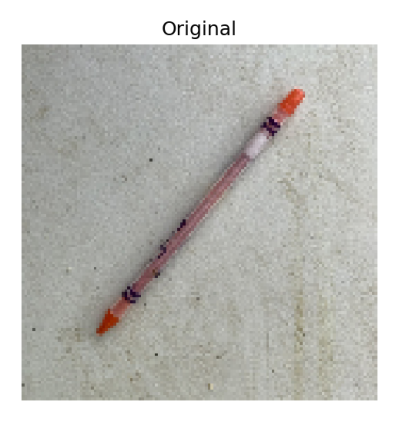

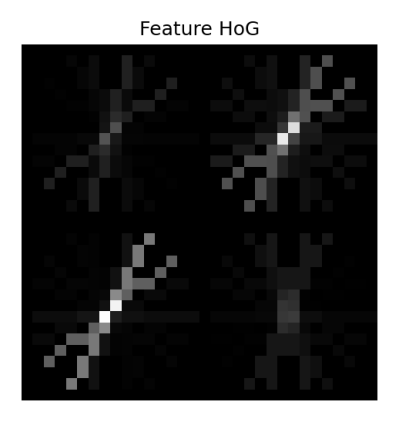

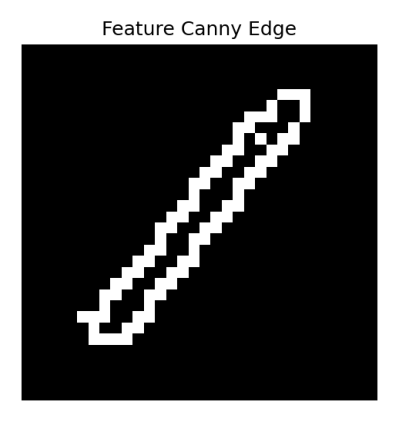

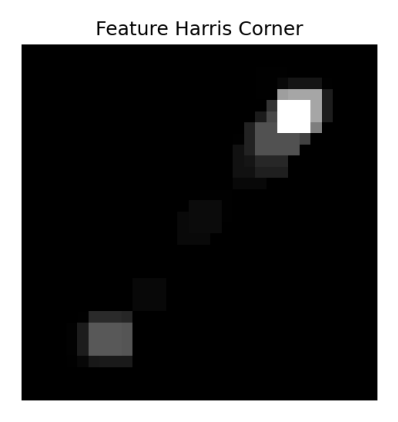

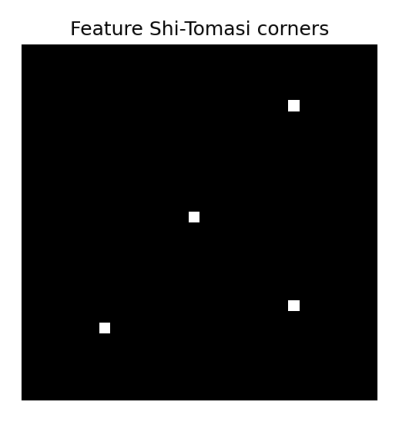

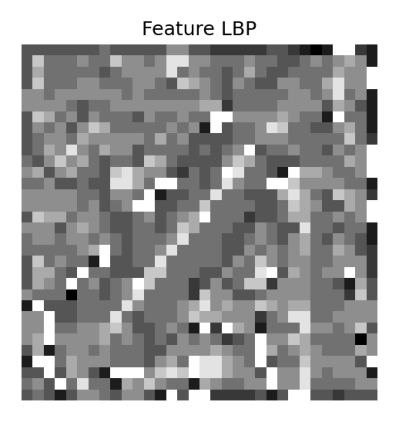

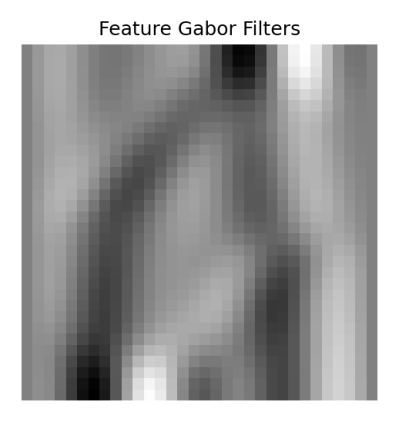

Epoch 30 Train Loss: 0.1033 | Train Acc : 0.9642 | Val Loss : 2.9389 | Val Acc : 0.4395


Epoch 31 Train Loss: 0.1219 | Train Acc : 0.9579 | Val Loss : 2.8625 | Val Acc : 0.4427


Epoch 32 Train Loss: 0.1320 | Train Acc : 0.9547 | Val Loss : 2.8739 | Val Acc : 0.4259


Epoch 33 Train Loss: 0.1411 | Train Acc : 0.9534 | Val Loss : 2.8690 | Val Acc : 0.4395


Epoch 34 Train Loss: 0.1459 | Train Acc : 0.9513 | Val Loss : 2.9094 | Val Acc : 0.4280


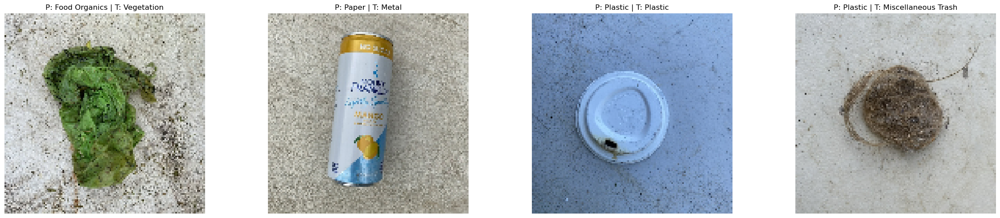

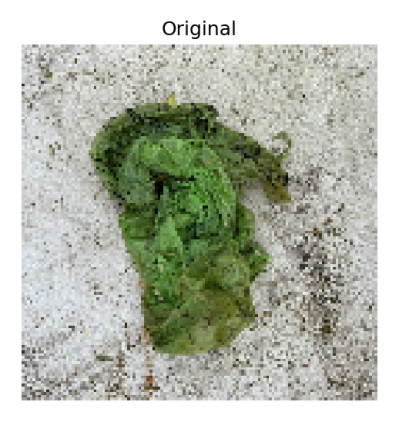

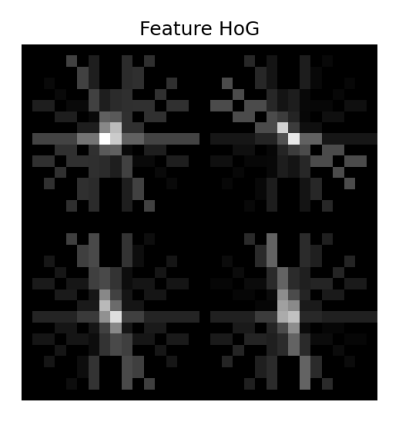

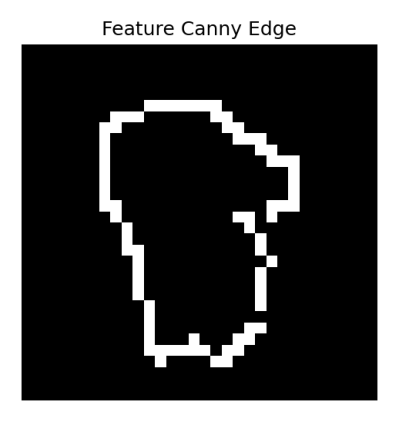

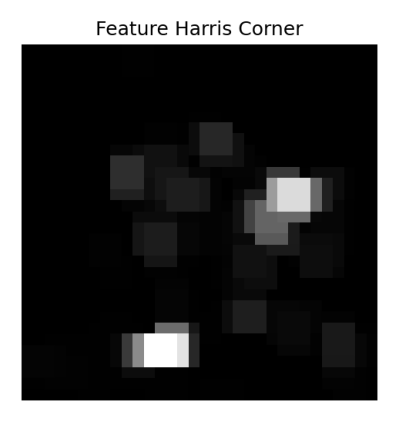

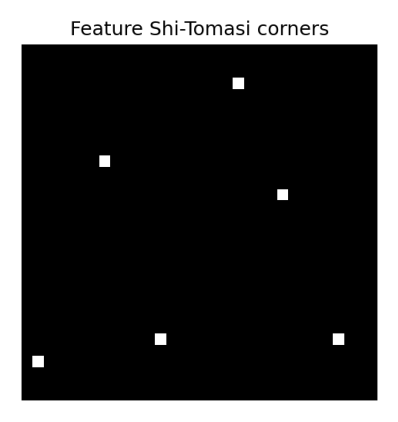

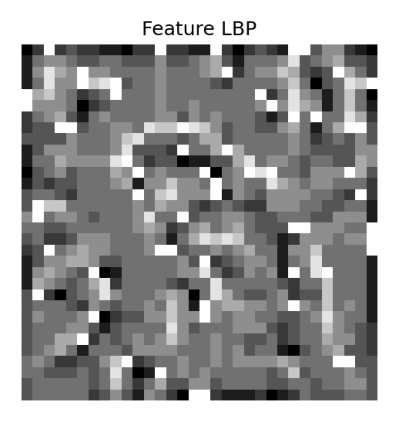

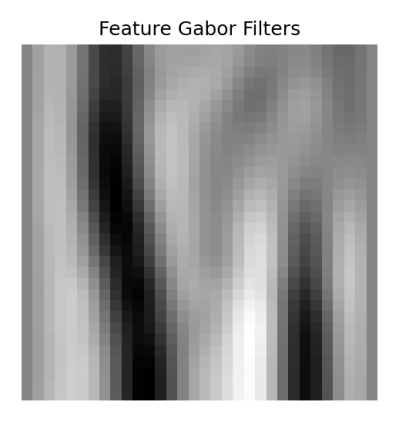

Epoch 35 Train Loss: 0.1183 | Train Acc : 0.9608 | Val Loss : 2.9614 | Val Acc : 0.4259


Epoch 36 Train Loss: 0.0982 | Train Acc : 0.9692 | Val Loss : 2.8368 | Val Acc : 0.4522


Epoch 37 Train Loss: 0.1130 | Train Acc : 0.9590 | Val Loss : 2.9359 | Val Acc : 0.4311


Epoch 38 Train Loss: 0.1409 | Train Acc : 0.9542 | Val Loss : 2.7837 | Val Acc : 0.4269


Epoch 39 Train Loss: 0.1051 | Train Acc : 0.9645 | Val Loss : 2.9005 | Val Acc : 0.4196


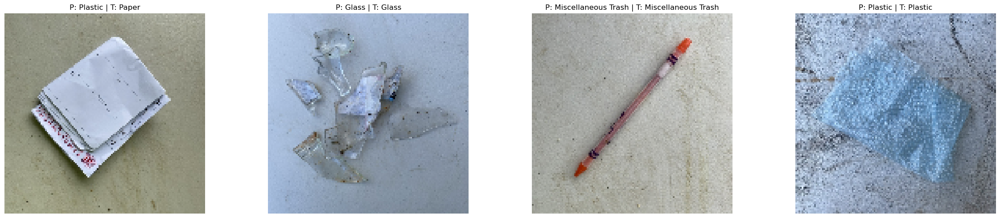

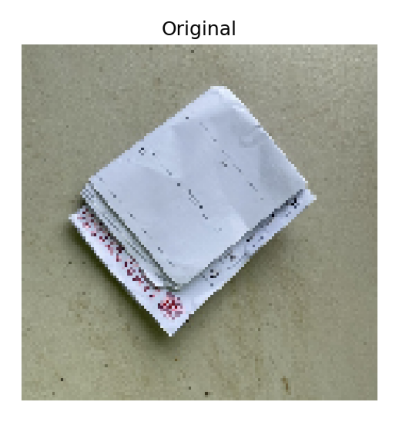

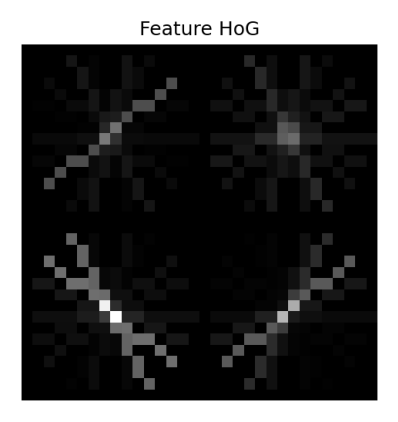

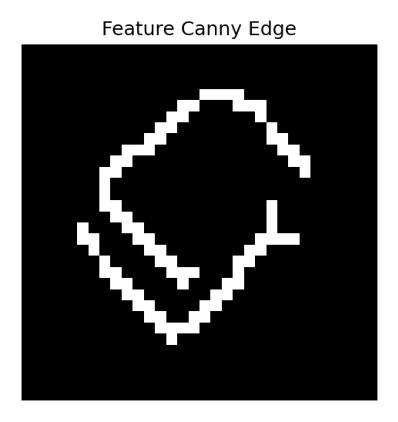

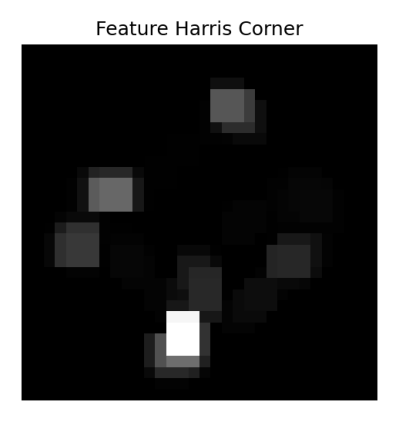

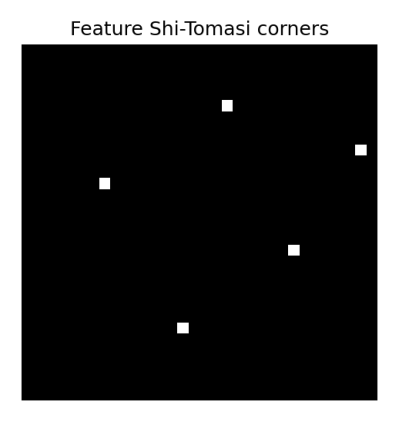

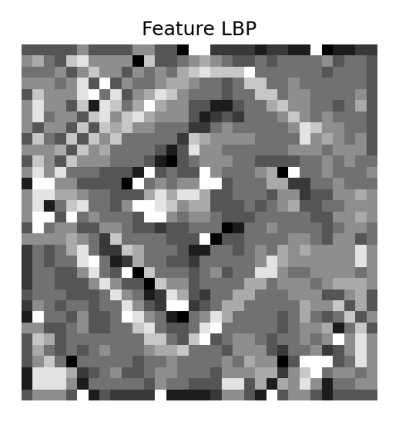

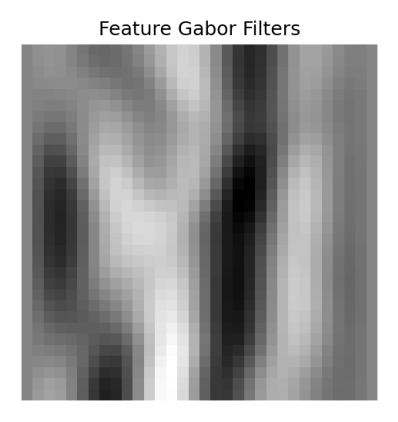

Epoch 40 Train Loss: 0.1184 | Train Acc : 0.9592 | Val Loss : 3.0408 | Val Acc : 0.4364


In [46]:
for train_loss,train_acc,val_loss,val_acc,fig in classic_trainer.train(epochs=EPOCHS,visualize_every=VIS_EVERY):
    pass

In [47]:
dt = time.time()-start_time
print(f"Training took {dt} seconds")

Training took 648.6690366268158 seconds


In [48]:
classic_model.save(os.path.join('trained_model','classic_model.pt'))

Model saved to trained_model\classic_model.pt


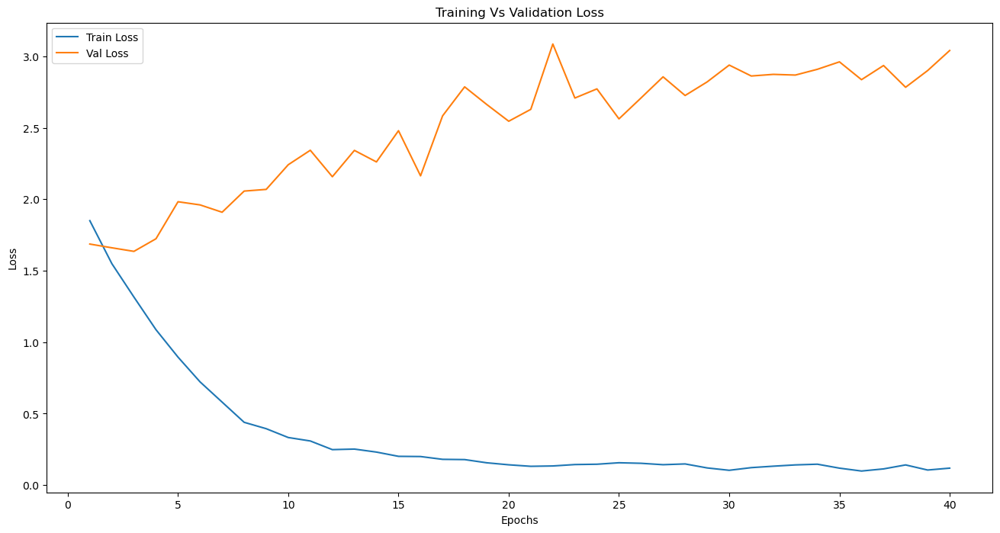

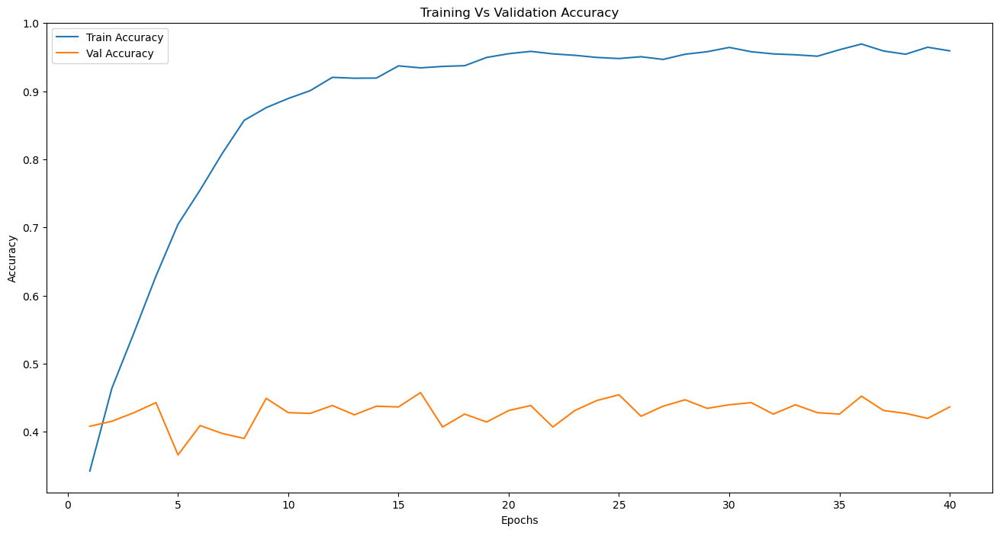

In [49]:
plot([train_loss,val_loss],['Train Loss','Val Loss'],'Epochs','Loss','Training Vs Validation Loss')
plot([train_acc,val_acc],['Train Accuracy','Val Accuracy'],'Epochs','Accuracy','Training Vs Validation Accuracy')